# MINDD - 2st Assignment

### Jorge Martins - 1050497
### Patrícia Vicente - 1050532

## Main objective of this assignment
The main purpose of this project is to develop predictive models for traffic volume using a reduced version of the Metro Interstate Traffic Volume dataset, to cover the period from July 2016 to 2018. The dataset offers a rich variety of features, including temporal data, weather conditions, and observed traffic volume, making it an ideal candidate for advanced forecasting techniques.

Traffic volume forecasting is critical for transportation planning, optimizing infrastructure use, and enhancing commuter experiences. Accurate predictions can help mitigate congestion, plan roadworks, and respond to adverse weather conditions effectively. 

This project adopts the CRISP-DM methodology, a structured and iterative process that ensures comprehensive analysis and robust model development.

To achieve the aim of correctly predict traffic volume, we will experiment with three categories of predictive models:

- Statistical Models: Time-series techniques, such as ARIMA, tailored to handle manageable subsets of the data.
- Machine Learning Models: Regression algorithms leveraging relationships between features for prediction.
- Deep Learning Models: Recurrent Neural Networks (LSTM and GRU) to capture temporal dependencies in the data.

By implementing this predictive models and analysing its results, we aim to identify the most effective techniques for traffic volume forecasting and demonstrate the practical value of data-driven insights in traffic management.

## Imports of the necessary libraries

In order to get an easy to understand code, all the necessary libraries to perform the analysis of the given dataset are imported first. This libraries cover a range of tools for data manipulation, visualization, preprocessing, model training, and evaluation.

In [1]:
import pandas as pd
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import TimeSeriesSplit
from sklearn.model_selection import train_test_split
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.api import ExponentialSmoothing

from statsforecast import StatsForecast
from statsforecast.models import Naive, SeasonalNaive, WindowAverage, SeasonalWindowAverage

import itertools
from itertools import product
from statsmodels.stats.diagnostic import acorr_ljungbox
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, mean_absolute_error
from typing import Union
from IPython.display import Markdown, display

# Supressing the warning messages
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)

from typing import Union
import plotly.express as px
from joblib import Parallel, delayed

from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import BaggingRegressor, GradientBoostingRegressor, RandomForestRegressor

from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

import plotly.io as pio
pio.renderers.default='notebook'

## Data Exploration and Preparation
An initial data exploration to understand the structure, content and potential issues is essential in every dataset. Checking the type of variables (numeric or categorical), missing data, duplicate values and inconsistencies is crucial to understand the dataset in order to perform the necessary cleaning and preprocessing to get a dataset that is ready to use to make the best predictions possible. Therefore, these steps set the foundation for a clean, well-understood dataset, ensuring that the subsequent phases of pre-processing and modeling are effective and robust.

### Load the Dataset and Understand the Data

In [2]:
# Load the dataset
df = pd.read_csv('Metro_Interstate_Traffic_Volume_reduced.csv')

# Display the basic information of the dataset
print("Dataset Information\n")

# Display the first few rows of the dataset
print("First few rows of the dataset:") 
print(df.head(),"\n")

# Display shape of the dataset
print(f"Rows: {df.shape[0]}, Columns: {df.shape[1]}", "\n")

# Display the data types of the columns
print(f"Numeric columns: {df.select_dtypes(include=np.number).columns.tolist()}", "\n")
print(f"Categorical columns: {df.select_dtypes(include='object').columns.tolist()}", "\n")

# Check for missing values
print("Missing values in each column:")
print(df.isnull().sum(), "\n")
print(f"Columns with missing values: {df.columns[df.isnull().sum() > 0].tolist()}", "\n")
print(f"Columns with no missing values: {df.columns[df.notnull().all()].tolist()}", "\n")

# Check for duplicate rows
print(f"Duplicate rows: {df.duplicated().sum()}", "\n")

# Basic statistics for numeric columns
print("Descriptive Statistics for Numeric Columns:")
print(df.describe(), "\n")

# Basic statistics for each column
for col in df.select_dtypes(include='object').columns:
    print(f"Column: {col}")
    print(f"Unique values:", df[col].nunique())
    print(f"Most frequent value:", df[col].mode()[0], "\n")

# Check if the column is consistent
def check_column_type_consistency(data, column):
    # Get the type of each element in the column
    types = data[column].map(type)
    # Check if there is only one unique type
    return types.nunique() == 1

inconsistent_columns = []
for col in df.columns:
    if not check_column_type_consistency(df, col):
        inconsistent_columns.append(col)
        print(f"Inconsistent types found in column {col}", "\n")
if not inconsistent_columns:
    print("All columns have consistent types", "\n")

Dataset Information

First few rows of the dataset:
             date_time holiday weather_main weather_description  rain_1h  \
0  2016-07-01 00:00:00     NaN        Clear        sky is clear      0.0   
1  2016-07-01 01:00:00     NaN        Clear        sky is clear      0.0   
2  2016-07-01 02:00:00     NaN        Clear        sky is clear      0.0   
3  2016-07-01 03:00:00     NaN        Clear        sky is clear      0.0   
4  2016-07-01 04:00:00     NaN        Clear        sky is clear      0.0   

   snow_1h  clouds_all    temp  traffic_volume  
0      0.0           1  289.04             825  
1      0.0           1  288.16             531  
2      0.0           1  286.64             381  
3      0.0           1  285.39             406  
4      0.0           1  284.67             790   

Rows: 23622, Columns: 9 

Numeric columns: ['rain_1h', 'snow_1h', 'clouds_all', 'temp', 'traffic_volume'] 

Categorical columns: ['date_time', 'holiday', 'weather_main', 'weather_description'] 



## Data Cleaning
This process helps identifying and correct errors, inconsistencies, and inaccuracies in the dataset to ensure it's accuracy, consistency, and that is ready for following analysis and modeling.

This is a critical step as the quality of the data directly impacts the quality of the insights or models.

### Checking for constant values
Features that have constant values in the dataset are typically non-informative, they provide no variability and thus no predictive power.

Identifying constant values helps to:
- Reduce redundancy and noise in the dataset.
- Focus computational resources on features that are more meaningful.
- Simplify the dataset, leading to better model interpretability.

In [3]:
# Check for duplicates
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

# Drop duplicates
df.drop_duplicates(inplace=True)

# Checking for constant values
print(df[['rain_1h', 'snow_1h']].describe())
rain_zeros = df[df['rain_1h'] == 0.0].shape[0]
snow_zeros = df[df['snow_1h'] == 0.0].shape[0]

print(f"Count of values in 'rain_1h' that are 0.0: {rain_zeros}")
print(f"Count of values in 'snow_1h' that are 0.0: {snow_zeros}")

# Checking the shape of the dataset after removing duplicates
print(f"Dataset shape after removing missing data, duplicates, and constant values: {df.shape}")

Number of duplicate rows: 15
            rain_1h  snow_1h
count  23607.000000  23607.0
mean       0.495011      0.0
std       63.989952      0.0
min        0.000000      0.0
25%        0.000000      0.0
50%        0.000000      0.0
75%        0.000000      0.0
max     9831.300000      0.0
Count of values in 'rain_1h' that are 0.0: 22590
Count of values in 'snow_1h' that are 0.0: 23607
Dataset shape after removing missing data, duplicates, and constant values: (23607, 9)


As can be seen by the results, `'snow_1h'` and `'rain_1h'` can be removed as they do not contribute to understanding variability or patterns in the data. `'snow_1h'` is made up entirely of a single value (0.0) and `'rain_1h'` has the same value (0.0) in more than 95% of the entries. Besides that the information is redundant with the `'weather_main'` feature.

The feature `'weather_description'` adds noise and the similar information as `'weather_main'` adding complexity to the models without improving predictability and increasing computational load. For this reason it will also be removed.

This features will be dropped to ensure an optimized dataset for the modeling phase.

### Dropping duplicates, columns that are redundant or have constant values in more than 90%
After identifying the features that are causing issues to the dataset, they will be removed

In [4]:
# Drop the columns 'rain_1h' and 'snow_1h'
df.drop(['rain_1h', 'snow_1h'], axis=1, inplace=True)

# # The column 'holiday' has a lot of missing data, so we will drop it
# df.drop('holiday', axis=1, inplace=True)

# The column 'weather_description' is redundant as it contains the same information as the 'weather_main' column
df.drop('weather_description', axis=1, inplace=True)

By removing duplicate entries and redundant columns, we streamline the dataset, making it more efficient for analysis and modeling. This cleaning process helps in reducing noise and potential biases, leading to more accurate and reliable predictive models. 

### Converting Date and Temperature

Data type conversion is an essential step in data preprocessing as it ensures that each column in our dataset is in the appropriate format, which can improve the efficiency of data manipulation and model training.
In this situation the data in the column `'date_time'` will be converted to <b>datetime</b> and the temperature will be converted to <b>Celsius</b> to better understanding.

In [5]:
# Convert the date_time column to datetime format
df['date_time'] = pd.to_datetime(df['date_time'])

# Converting temperature from Kelvin to Celsius
df['temp'] = df['temp'] - 273.15

### Treating `'holiday'` column
This feature indicates whether a given date is a holiday, which can significantly impact traffic volume. Properly encoding and handling this column is crucial for accurate model predictions.
As seen before, this column has missing values for non-holidays dates, so we're going to encode this column as binary values first.

It was observed that a holiday might be recorded for only one hour of a given day. Therefore to ensure consistency, this column will be updated so that if any hour of a day is marked as a holiday, all hours of that day are also marked as holidays. This step ensures that our models correctly interpret the impact of holidays on traffic volume.

In [6]:
# Apply holiday encoding to 1 and 0
df['holiday'] = df['holiday'].fillna('None').apply(lambda x: 1 if x != 'None' else 0)

# print number of records where holiday is not None
print(df[df['holiday'] != 0].shape[0])

# Update the records where a certain date has a holiday but only in one hour and replicate for the other hours of that same day
df['holiday'] = df.groupby(df['date_time'].dt.date)['holiday'].transform('max')

# print number of records where holiday is not None
print(df[df['holiday'] != 0].shape[0])

31
745


By encoding the `'holiday'` column and ensuring consistency across all hours of a holiday, we enhance the quality of our dataset. This will able to accurately capture the impact of holidays on traffic volume, leading to more reliable and robust predictive models.

### Encoding categorical variables
Categorical variables need to be converted into a numerical format that machine learning algorithms can process. We achieve this using one-hot encoding, a technique that converts categorical variables into a series of binary columns. Each unique category value becomes a new column, and a binary value (0 or 1) indicates the presence of that category in the original data. 

In [7]:
# Encode categorical variables using one-hot encoding
df = pd.get_dummies(df, columns=['weather_main'], drop_first=True)

# Exclude the date_time column before converting to int
df[df.columns.difference(['date_time'])] = df[df.columns.difference(['date_time'])].astype(int)

# Exclude all columns that were not created by one-hot encoding
one_hot_encoded_columns = df.columns.difference(['date_time', 'holiday', 'clouds_all', 'temp', 'traffic_volume'])
df = df[['date_time', 'holiday', 'clouds_all', 'temp', 'traffic_volume'] + list(one_hot_encoded_columns)]

This process ensures that categorical data is represented in a numerical format, making it suitable for analysis and modeling. By converting data types and organizing columns, it ensures a cleaner and more efficient dataset.

### Checking for time gaps in the dataframe
Checking that the time series data is continuous and without significant gaps is crucial for accurate time series analysis and modeling.

In [8]:
def check_time_gaps(dataframe):
    """
    Check for gaps of hours between consecutive records in date_time column.

    Parameters:
    dataframe (pd.DataFrame): The input dataframe with a 'date_time' column.

    Returns:
    pd.DataFrame: A dataframe containing the gaps greater than 1 hour.
    """
    gaps_df = dataframe.copy()

    gaps_df['date_time'] = pd.to_datetime(gaps_df['date_time'])
    gaps_df = gaps_df.sort_values(by='date_time')
    gaps_df['time_diff'] = gaps_df['date_time'].diff().dt.total_seconds() / 3600

    # Identify gaps greater than 1 hour
    gaps = gaps_df[gaps_df['time_diff'] > 1]

    # Display the gaps
    print(f"Number of gaps: {gaps.shape[0]}")
    print(gaps[['date_time', 'time_diff']])
    
    return gaps

# Call the method
gaps = check_time_gaps(df)

Number of gaps: 80
                date_time  time_diff
310   2016-07-12 10:00:00        2.0
313   2016-07-12 14:00:00        2.0
317   2016-07-12 18:00:00        2.0
333   2016-07-13 10:00:00        2.0
337   2016-07-13 14:00:00        2.0
...                   ...        ...
18145 2018-03-29 03:00:00        2.0
19239 2018-05-05 03:00:00        2.0
20027 2018-06-02 03:00:00        2.0
21924 2018-08-07 10:00:00        4.0
22356 2018-08-23 03:00:00        2.0

[80 rows x 2 columns]


### Treating time gaps in the dataframe using resampling

In [9]:
# Set date_time as the index
el_df = df.set_index('date_time')

# Resample the data to hourly frequency
final_df = el_df.resample('H').mean()

# Fill missing values using the backfill method
final_df.fillna(method='bfill', inplace=True)

# Check for missing values
print ("\nMissing values :")
print(final_df.isna().sum())


Missing values :
holiday                      0
clouds_all                   0
temp                         0
traffic_volume               0
weather_main_Clouds          0
weather_main_Drizzle         0
weather_main_Fog             0
weather_main_Haze            0
weather_main_Mist            0
weather_main_Rain            0
weather_main_Smoke           0
weather_main_Snow            0
weather_main_Squall          0
weather_main_Thunderstorm    0
dtype: int64


By setting the date_time column as the index, resampling the data to an hourly frequency, and filling missing values according to a backward fill strategy that proved to be the most effective after testing, we ensure that our time series data is continuous and complete. These steps are essential for accurate time series analysis and modeling, providing a solid foundation for the predictive models.

Other methods for filling missing values were interpolation and forward fill but backward fill produced the best results with more consistency.

### Outliers detection and handling

Detecting and addressing outliers is crucial for improving the accuracy and reliability of predictive models.

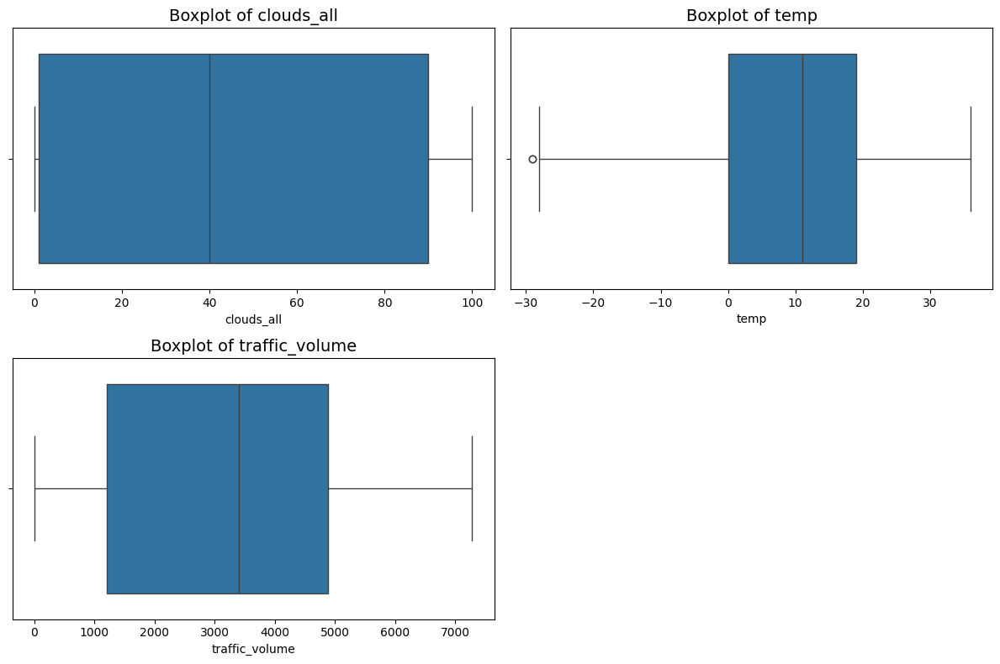

Column: clouds_all, Number of Outliers: 0
Column: temp, Number of Outliers: 2
Column: traffic_volume, Number of Outliers: 0


In [10]:
# List of numeric columns to check for outliers
numeric_columns = ['clouds_all', 'temp', 'traffic_volume']

# Calculate grid dimensions dynamically
n_cols = 2
n_rows = (len(numeric_columns) + n_cols - 1) // n_cols # Round up to fit all columns

# Create the subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))

# Flatten axes for easy indexing
axes = axes.flatten()

# Remove any empty subplots
for i, column in enumerate(numeric_columns):
    sns.boxplot(x=df[column], ax=axes[i])
    axes[i].set_title(f'Boxplot of {column}', fontsize=14)

# Remove any empty subplots
for j in range(len(numeric_columns), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

# Fucntion to detect outliers using IQR
# Combine repetitive operations (like calculating IQR) into helper functions to avoid duplication.
def calculate_iqr_bounds(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    return Q1 - 1.5 * IQR, Q3 + 1.5 * IQR

# Detect and count outliers
outliers_dict = {}
for column in numeric_columns:
    lower_bound, upper_bound = calculate_iqr_bounds(df, column)
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    outliers_dict[column] = len(outliers)
    print(f"Column: {column}, Number of Outliers: {len(outliers)}")

Identifying and handling outliers is a critical step, since they can distort statistical analyses and model predictions, leading to inaccurate results. By using boxplots and the IQR method, we can effectively identify outliers in our dataset. 
As we could observe, only the column `'temp'` has a small number of outliers. Since it is a low number of outliers they will not be removed. Instead, they will be treated using a weighting mechanism.

#### Treat outliers using a weighting mechanism
A weighing mechanism assigns weights to data points based on their distance from the central tendency (e.g., mean or median). Outliers, which are far from the central tendency, receive lower weights, reducing their impact on the model. 
This approach allows us to mitigate the influence of outliers without completely removing them from the dataset.

               temp
count  23607.000000
mean       9.133689
std       12.084256
min      -28.000000
25%        0.000000
50%       11.000000
75%       19.000000
max       36.000000


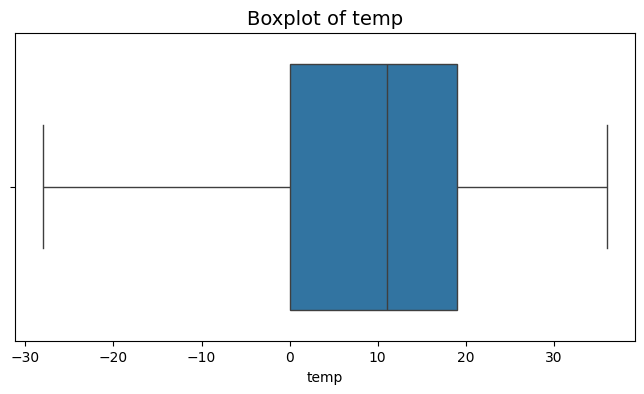

In [11]:
# Function to apply weighted treatment to outliers
def treat_outliers(df, column, lower_bound, upper_bound):
    median = df[column].median()
    df[column] = np.where(df[column] < lower_bound, median, df[column])
    df[column] = np.where(df[column] > upper_bound, median, df[column])
    return df

# Apply the function to the 'temp' column
lower_bound, upper_bound = calculate_iqr_bounds(df, 'temp')
df = treat_outliers(df, 'temp', lower_bound, upper_bound)

# Verify the changes
print(df[['temp']].describe())

# Plot the boxplot for the 'temp' column
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['temp'])
plt.title('Boxplot of temp', fontsize=14)
plt.show()

Replacing the outliers with the median value helps in reducing their impact on the analysis and models. This approach ensures that our dataset remains comprehensive while minimizing the distortion caused by extreme values.

## Visualizing the Time Series
Visualizing the time series helps us understand the trends and patterns in traffic volume. Analyzing this trends and patterns is essential for building accurate predictive models.

In [12]:
fig = px.line(pd.concat([final_df['traffic_volume']], axis=1), title='Traffic Volume Over Time', width=1200, height=400)

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

fig.show()

## Analyze Stationarity
Stationarity is a crucial property for time series analysis and modeling, as many forecasting methods assume that the underlying time series is stationary.
To analyze the stationarity of the traffic_volume time series using the Augmented Dickey-Fuller (ADF) test which is a statistical test used to determine whether a given time series is stationary. A stationary time series has properties such as mean, variance, and autocorrelation that do not change over time. The null hypothesis of the ADF test is that the time series is non-stationary.
- If the p-value is greater than 0.05, we fail to reject the null hypothesis, indicating that the time series is non-stationary. In this case, differencing is required to make the series stationary.
- If the p-value is less than or equal to 0.05, we reject the null hypothesis, indicating that the time series is stationary.

In [13]:
ADF_result = adfuller(final_df['traffic_volume'])
print('ADF Statistic: ', round(ADF_result[0], 3))
print('p-value: ', round(ADF_result[1], 3))

if ADF_result[1] > 0.05:
    print("The series is non-stationary. Differencing is required.")
else:
    print("The series is stationary because p-value is less than 0.05")

ADF Statistic:  -17.688
p-value:  0.0
The series is stationary because p-value is less than 0.05


## Analyze seasonality
Seasonality refers to periodic fluctuations in the data that occur at regular intervals, such as daily, weekly, or yearly patterns. Understanding seasonality is crucial for accurate time series modeling and forecasting.

Seasonal decomposition is a technique that separates a time series into three components: trend, seasonal, and residual. The function seasonal_decompose from the statsmodels library will be used to perform this decomposition.

The decomposed components are:
- <b>Trend Component:</b> represents the long-term movement in the data, showing the overall direction of the time series.
- <b>Seasonal Component:</b> captures the repeating patterns or cycles in the data, such as daily or weekly fluctuations.
- <b>Residual Component:</b> represents the remaining variability in the data after removing the trend and seasonal components. It captures the noise or irregular fluctuations.

In [14]:
# Perform seasonal decomposition
result = seasonal_decompose(final_df['traffic_volume'], model='additive', period=24)

# Plot the decomposed components using plotly.express with slider
fig = px.line(result.trend.reset_index(), x='date_time', y='trend', title='Trend Component', width=1200, height=400)
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig.show()

fig = px.line(result.seasonal.reset_index(), x='date_time', y='seasonal', title='Seasonal Component', width=1200, height=400)
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig.show()

fig = px.line(result.resid.reset_index(), x='date_time', y='resid', title='Residual Component', width=1200, height=400)
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig.show()

The <b>trend</b> component shows that traffic volume fluctuates but remains relatively stable overall.
There are periodic dips, particularly in early 2017 and mid-2018, which could correspond to external events like holidays, infrastructure issues, or weather conditions.
The general level of traffic volume appears to slightly increase toward the end of the time frame.

The <b>seasonal</b> component demonstrates strong periodic behavior, likely reflecting daily or weekly traffic cycles.
The magnitude of seasonal fluctuations remains consistent throughout the entire series.
Peaks and troughs in the seasonal component suggest high traffic at certain times (e.g., weekdays) and lower traffic during other times (e.g., weekends or nights).

The <b>residual</b> component appears evenly distributed around zero, which is desirable for a well-decomposed time series.
However, occasional spikes in the residuals suggest irregular events (e.g., accidents, sudden weather changes, or other anomalies affecting traffic).

Analyzing seasonality through seasonal decomposition provides valuable insights into the underlying patterns of the `'traffic_volume'` time series. By separating the data into trend, seasonal, and residual components, we will be able to understand the periodic fluctuations and long-term movements in the data. These insights are crucial for building accurate and reliable time series models, enabling us to make more informed predictions and decisions.

## Autocorrelation and Partial Autocorrelation plots
By analizing the autocorrelation and partial autocorrelation of the `'traffic_volume'` time series will able the understanding of the dependencies and relationships within the time series data.

The <b>Autocorrelation Function (ACF)</b> measures the correlation between the time series and its lagged values. It helps us identify the presence of patterns, such as seasonality or trends, by showing how the data points are related to each other over different time lags.

The <b>Partial Autocorrelation Function (PACF)</b> measures the correlation between the time series and its lagged values, while controlling for the values of the intermediate lags. It helps us identify the direct relationships between the data points at different lags, which is useful for determining the order of autoregressive models.

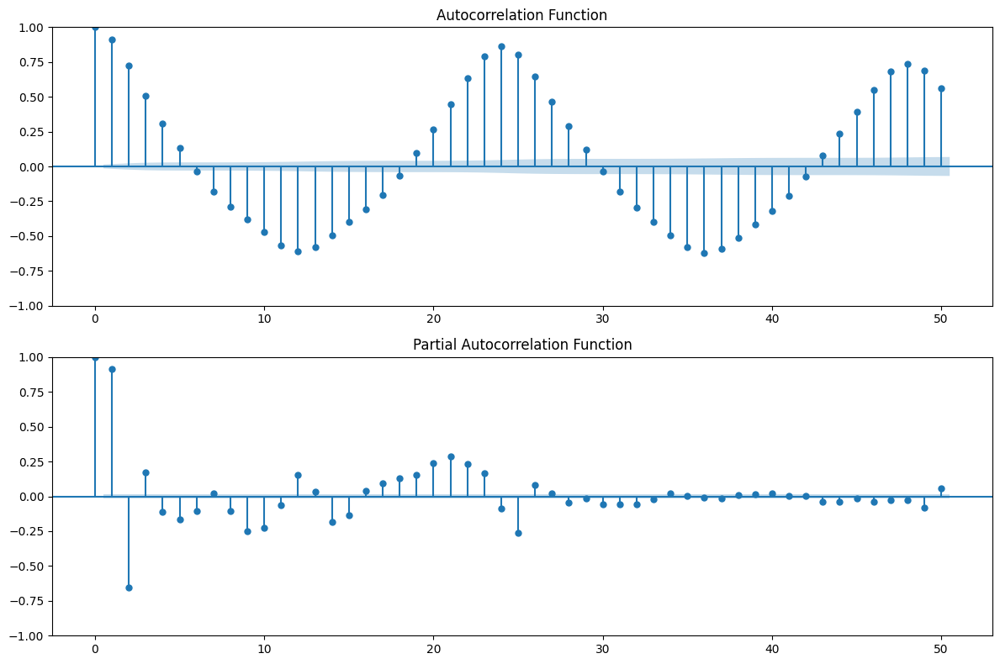

In [15]:
fig, ax = plt.subplots(2, 1, figsize=(12, 8))

# Plot ACF
plot_acf(final_df['traffic_volume'], ax=ax[0], lags=50)
ax[0].set_title('Autocorrelation Function')

# Plot PACF
plot_pacf(final_df['traffic_volume'], ax=ax[1], lags=50)
ax[1].set_title('Partial Autocorrelation Function')

plt.tight_layout()
plt.show()

Regarding the <b>ACF plot</b> there are some conclusions to take into account:
- There is a strong positive autocorrelation at lag 1, which gradually decreases, oscillating between positive and negative values. 
- The sinusoidal pattern indicates seasonality or cyclic behavior in the time series data.
- The correlations eventually taper off, suggesting that the seasonal effect weakens over time.

The seasonality or periodic component is evident in the data. The gradual decay suggests that an ARMA or seasonal model might be a good fit for the data.

As for the <b>PACF plot</b> we can observe:
- There is a significant spike at lag 1, followed by smaller spikes at higher lags.
- The spikes become insignificant beyond lag 2, indicating that most of the information about the current value can be explained by the first and second lagged observations.

The significant spikes at lags 1 and 2 suggest that an AR(2) model (AutoRegressive of order 2) might be appropriate to capture the autoregressive structure of the time series.

Further on this notebook, we will going to find the optimal parameters

## Split data into train and test set
By training the model on one subset of the data and testing it on another, we can assess how well the model generalizes to unseen data.

The dataset was divided based on a specific date, ensuring that the training set contains data from July 1, 2016, to September 16, 2018, and the testing set contains data from September 16, 2018, onwards. This chronological split helps us simulate a real-world scenario where we train the model on past data and test it on future data.

In [16]:
train = final_df[(final_df.index.get_level_values(0) >= '2016-07-01') & (final_df.index.get_level_values(0) <= '2018-09-16')]

test = final_df[(final_df.index.get_level_values(0) >= '2018-09-16')]

In [17]:
aux_final_df = final_df.copy()
aux_train = train.copy()
aux_test = test.copy()

## Statistical Models
### ARMA
The ARMA model (Autoregressive Moving Average model) is a popular statistical model used for time series analysis and forecasting. It combines two key components: Autoregression (AR) and Moving Average (MA), and it assumes that the data is stationary.

The AR model is defined by the parameter p, which specifies the number of lagged observations included.
The MA model is defined by the parameter q, which specifies the number of past error terms included.

#### Find optimal parameters (p, q)

In [18]:
# plot the train and test data
fig = px.line(aux_train['traffic_volume'], title='Traffic Volume Over Time', width=1200, height=400)

# Add the test data to the plot
fig.add_scatter(x=aux_test.index, y=aux_test['traffic_volume'], mode='lines', name='Test')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

# Set axis titles
fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

fig.show()

Exogenous variables provide additional context and explanatory power to a model. By including them, we're incorporating information beyond the past values of the dependent variable, which can improve the model's ability to make accurate predictions.

In [19]:
# Define the columns to be used as exogenous variables
exog_columns = [col for col in aux_final_df.columns if col not in ['traffic_volume']]

print('Exogenous variables:', exog_columns)
print('Number of exogenous variables:', len(exog_columns))

Exogenous variables: ['holiday', 'clouds_all', 'temp', 'weather_main_Clouds', 'weather_main_Drizzle', 'weather_main_Fog', 'weather_main_Haze', 'weather_main_Mist', 'weather_main_Rain', 'weather_main_Smoke', 'weather_main_Snow', 'weather_main_Squall', 'weather_main_Thunderstorm']
Number of exogenous variables: 13


To evaluate the model, we are going to define a function to evaluate a single SARIMAX model a return its parameters and AIC.

The AIC (Akaike Information Criterion) is a measure of the model's quality, with lower values indicating better models.

In [58]:
def evaluate_model(train, param, exog_columns=None):

    try:
        if exog_columns is not None:
            exog = train[exog_columns]
            model = SARIMAX(train['traffic_volume'], exog=exog, 
                            order=(param[0], 0, param[1]), 
                            simple_differencing=False)
        else:
            model = SARIMAX(train['traffic_volume'], 
                            order=(param[0], 0, param[1]), 
                            simple_differencing=False)
        result = model.fit(disp=False)
        return param[0], param[1], result.aic
    except:
        # Return None if model fitting fails
        return param[0], param[1], None

def find_best_arma_params(train, exog_columns=None, n_jobs=-1):

    # Define the p and q parameters to take any value between 0 and 5
    p = q = range(0, 5)

    # Generate all different combinations of p and q
    pq = list(itertools.product(p, q))

    # Use joblib's Parallel and delayed for parallel execution
    results = Parallel(n_jobs=n_jobs)(
        delayed(evaluate_model)(train, param, exog_columns) for param in pq
    )

    # Convert results into a DataFrame
    results_df = pd.DataFrame(results, columns=['p', 'q', 'AIC'])

    # Drop rows where AIC is None (failed models)
    results_df = results_df.dropna()

    # Find the parameters with minimal AIC
    best_params = results_df.loc[results_df['AIC'].idxmin()]

    return best_params

# # without exogenous variables
# best_params = find_best_arma_params(aux_train, n_jobs=-1)

# print('Best p:', best_params['p'])
# print('Best q:', best_params['q'])
# print('Best AIC:', best_params['AIC'])

# with exogenous variables
best_params_with_exog = find_best_arma_params(aux_train, exog_columns=exog_columns, n_jobs=-1)

print('Best p with exog:', best_params_with_exog['p'])
print('Best q with exog:', best_params_with_exog['q'])
print('Best AIC with exog:', best_params_with_exog['AIC'])

Best p with exog: 1.0
Best q with exog: 1.0
Best AIC with exog: 318831.3740417227


Using the ARMA model with exogenous variables helps us capture the underlying patterns in the traffic volume data more accurately. By evaluating different combinations of AR and MA parameters and selecting the best model based on AIC, we ensure that our model is both robust and reliable.

The best ARMA parameters for this model are:
- p: 1
- q: 1
- AIC: 318831.3740417227

Visualizing the training and testing data, defining exogenous variables, and interpreting the model results are crucial steps in building an effective time series forecasting model.

#### Fit the ARMA(p,q) model with the optimal parameters on the training set

The ARMA model is going to be fitted with the optimal parameters on the training set. This step involves using the best AR and MA parameters identified earlier and incorporating exogenous variables to improve the model's accuracy.

                               SARIMAX Results                                
Dep. Variable:         traffic_volume   No. Observations:                19369
Model:                 ARIMA(1, 0, 1)   Log Likelihood             -153395.964
Date:                Sun, 22 Dec 2024   AIC                         306825.928
Time:                        12:29:18   BIC                         306959.742
Sample:                    07-01-2016   HQIC                        306869.776
                         - 09-16-2018                                         
Covariance Type:                  opg                                         
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                      2870.2138     64.269     44.660      0.000    2744.249    2996.178
holiday                    -686.5835     58.035    -11.830      0.000    -800.330    -

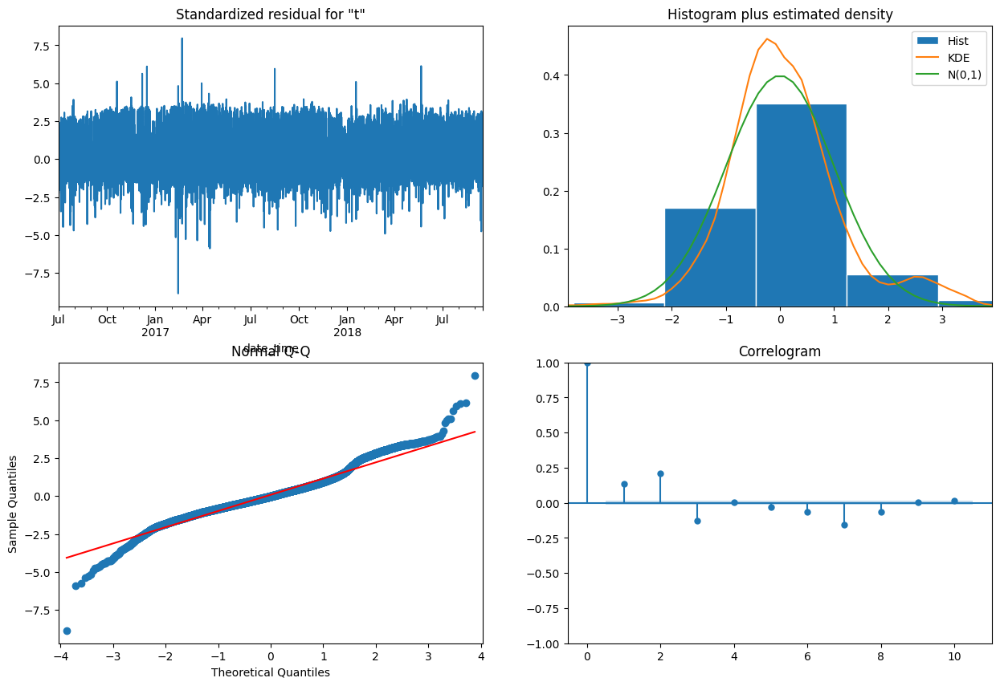

In [ ]:
# Define the exogenous variables
exog = aux_train[exog_columns]

# Fit the ARMA model with the optimal parameters on the training set
#arma_model = ARIMA(aux_train['traffic_volume'], order=(int(best_params['p']), 0, int(best_params['q']))).fit()

# Fit the ARMA model with the optimal parameters and exogenous variables on the training set
arma_model = ARIMA(aux_train['traffic_volume'], exog=exog, order=(int(best_params_with_exog['p']), 0, int(best_params_with_exog['q']))).fit()
#arma_model = ARIMA(aux_train['traffic_volume'], exog=exog, order=(1, 0, 1)).fit()

print(arma_model.summary())

# Suppress automatic plot display
plt.ioff()
arma_model.plot_diagnostics(figsize=(15, 10))
plt.show()  # Explicitly show the plot

We can conclude based on the summary and plots obtained that:
- Holidays, temperature, and certain weather conditions (fog, squalls, thunderstorms) are significant predictors of traffic volume.
- Traffic volume shows strong persistence over time, as evidenced by the autoregressive term.
- The model can explain a substantial portion of traffic variability
- Standardized Residuals for "t" plot: Show no clear pattern, which is good. However, spikes indicate occasional outliers.
- Histogram plus estimated density plot: Residuals deviate from a perfect normal distribution, though the shape is approximately bell-shaped.
- Normal Q-Q plot: The residuals deviate from the red line in the tails, suggesting the presence of outliers or heavy tails in the data.
- Correlogram: Shows some autocorrelation in the residuals. Ideally, all spikes should be within the confidence intervals, but here, significant lags indicate room for improvement.

#### Predict 15 days of traffic volume using the last 15 days of points as test set with ARMA
The ARMA model is going to be used to predict the traffic volume for 15 days. We use the last 15 days of data points as the test set to evaluate the model's performance.

In [21]:
predictions_arma=arma_model.get_prediction(n_periods=360, return_conf_int=True)
round_predictions_arma = round(predictions_arma.predicted_mean, 0)
forecast_arma_df = pd.DataFrame(round_predictions_arma[-len(test):].values, index=test.index, columns=['ARMA Prediction'])

# Clip any negative predictions to zero to avoid negative numbers
forecast_arma_df = forecast_arma_df.clip(lower=0)

The ARMA model generates predictions for the next 15 days based on the optimal parameters identified earlier. The predictions are rounded to the nearest integer and any negative values are clipped to zero to avoid unrealistic negative traffic volumes.

In [22]:
fig = px.line(pd.concat([aux_final_df['traffic_volume'], forecast_arma_df], axis=1), 
              title='Traffic Volume and Forecast Over Time', width=1200, height=400)

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

# Set axis titles
fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

fig.show()

The ARMA model (red line) captures the periodic fluctuations in traffic volume reasonably well. It aligns with the general cyclical trends observed in the actual traffic volume (blue line), especially during stable periods.

The ARMA model generally follows the peaks and troughs of the actual data but struggles with sharper transitions or anomalies.

There are instances where the ARMA predictions slightly lag or lead the actual data, which could result from the limited ability of ARMA to model strong seasonal effects or external influences.

The amplitude of the ARMA predictions seems slightly smoothed compared to the actual data. This smoothing occurs because ARMA focuses on capturing historical patterns but does not explicitly account for variability caused by factors like holidays, weather, or special events.

The ARMA model does not overfit noise in the data, which is good for generalization. However, this might cause it to miss sharp spikes or drops in the actual traffic volume.

### SARIMA
The SARIMA (Seasonal AutoRegressive Integrated Moving Average) model extends the ARIMA model by explicitly modeling the seasonal component of the time series, making it suitable for data with seasonal patterns.

The SARIMA model includes parameters for both the non-seasonal and seasonal components. The non-seasonal part is defined by the parameters (p, d, q), while the seasonal part is defined by the parameters (P, D, Q, s), where:
- p: Order of the autoregressive part.
- d: Degree of differencing.
- q: Order of the moving average part.
- P: Seasonal autoregressive order.
- D: Seasonal differencing order.
- Q: Seasonal moving average order.
- s: Length of the seasonal cycle.

#### Method to fit different SARIMA(p,_,q) models and select the best one (with lowest AIC value)
We are now fitting different SARIMA models and selecting the best one based on the lowest Akaike Information Criterion (AIC) value. Just has refered before, lower AIC values indicates better models.

In [23]:
def fit_sarima(data: Union[pd.Series, list], exog: pd.DataFrame, order: tuple, d: int, D: int, s: int):

    try:
        model = SARIMAX(data, exog=exog, order=(order[0], d, order[1]), 
                        seasonal_order=(order[2], D, order[3], s),
                        simple_differencing=False).fit(disp=False)
        aic = model.aic
        return [order[0], order[1], order[2], order[3], aic]
    except Exception as e:
        print(f"Error with order {order}: {e}")
        # In case of any error, return None (we'll filter them out later)
        return None

def optimize_SARIMA(data: Union[pd.Series, list], exog: pd.DataFrame, order_list: list, d: int, D: int, s: int):

    # Use Parallel to fit the SARIMAX models concurrently
    results = Parallel(n_jobs=-1)(delayed(fit_sarima)(data, exog, order, d, D, s) for order in order_list)
    
    # Filter out None values in case of failed fits
    results = [result for result in results if result is not None]

    # Convert results into a DataFrame
    result_df = pd.DataFrame(results, columns=['p', 'q', 'P', 'Q', 'AIC'])

    # Sort in ascending order (lower AIC is better)
    result_df = result_df.sort_values('AIC', ascending=True).reset_index(drop=True)

    return result_df

Optimizing SARIMA parameters is essential to build accurate and reliable time series forecasting models. By fitting different SARIMA models and selecting the best one based on the lowest AIC value, it is ensure that the model captures the underlying patterns in the data effectively. The optimize_SARIMA function provides a systematic approach to parameter optimization, enhancing the performance of the predictive models.

#### SARIMA(p,1,q)(P,1,Q)
The SARIMA model includes parameters for both the non-seasonal and seasonal components. For our model, we set the following values:

- d = 0: No non-seasonal differencing, because the time series is stationary.
- D = 1: One seasonal differencing, because seasonality is evident in the data.
- s = 24: Seasonal cycle length of 24 (e.g., daily seasonality for hourly data).

We explore different values for the parameters p, q, P, and Q within the range [0, 1, 2, 3].

In [24]:
d = 0
D = 1
s = 24

# Values [0, 1, 2, 3] for p, q, P, Q

ps = range(0, 3, 1)
qs = range(0, 3, 1)
Ps = range(0, 3, 1)
Qs = range(0, 3, 1)

# Generate unique combinations of values
parameters_SARIMA_order_list = list(product(ps, qs, Ps, Qs))

# Define the exogenous variables
exog_data = aux_train[exog_columns] 

By exploring different combinations of non-seasonal and seasonal parameters, we ensure that the model captures the underlying patterns in the data effectively. 
The use of exogenous variables further enhances the model's accuracy, providing a robust foundation for predicting traffic volume.

#### Find the optimal (p ,d ,q )(P ,D ,Q )m  parameters

In [26]:
# Find the optimal parameters using parallel processing and external regressors
optimal_params_sarima = optimize_SARIMA(aux_train['traffic_volume'], exog_data, parameters_SARIMA_order_list, d, D, s)

# Display the optimal parameters
print(optimal_params_sarima.head())

   p  q  P  Q            AIC
0  2  1  1  2  287179.445553
1  2  1  0  2  287180.508400
2  2  2  2  1  287275.797525
3  2  2  1  2  287302.877770
4  2  2  1  1  287345.556763


#### Best params for SARIMA

In [27]:
best_p_sarima = optimal_params_sarima.iloc[0, 0]
best_q_sarima = optimal_params_sarima.iloc[0, 1]
best_P_sarima = optimal_params_sarima.iloc[0, 2]
best_Q_sarima = optimal_params_sarima.iloc[0, 3]

display(Markdown(f"**SARIMA({best_p_sarima}, {d}, {best_q_sarima})({best_P_sarima}, {D}, {best_Q_sarima}, {s})**"))

**SARIMA(2, 0, 1)(1, 1, 2, 24)**

The best parameters found based on the 'optimal_params_sarima' function are:
- SARIMA(2, 0, 1)(1, 1, 2, 24)

#### Fit SARIMA model with optimal parameters on the training set

                                        SARIMAX Results                                        
Dep. Variable:                          traffic_volume   No. Observations:                19369
Model:             SARIMAX(2, 0, 1)x(1, 1, [1, 2], 24)   Log Likelihood             -143569.728
Date:                                 Sun, 22 Dec 2024   AIC                         287179.456
Time:                                         16:09:27   BIC                         287336.860
Sample:                                     07-01-2016   HQIC                        287231.037
                                          - 09-16-2018                                         
Covariance Type:                                   opg                                         
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
holiday                    -407.7258     36.

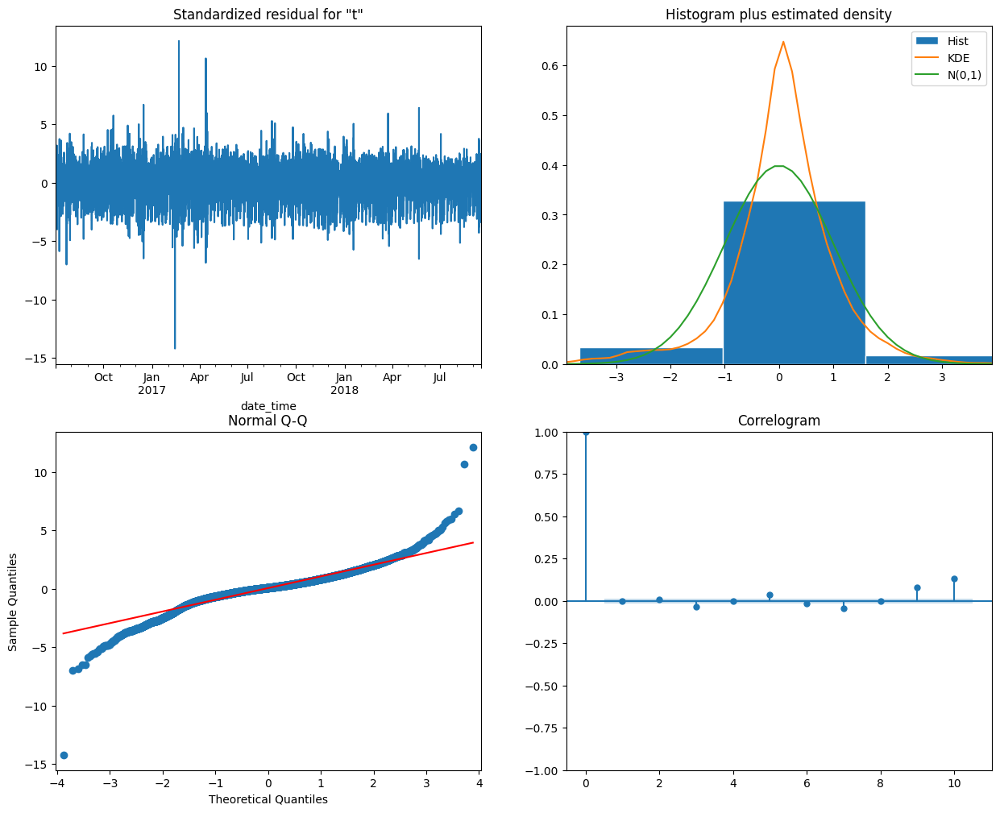

In [25]:
best_p_sarima = 2
best_q_sarima = 1
best_P_sarima = 1
best_Q_sarima = 2

# Fit the SARIMA model with the optimal parameters on the training set
sarima_model = SARIMAX(aux_train['traffic_volume'], exog_data, order=(best_p_sarima, d, best_q_sarima), seasonal_order=(best_P_sarima, D, best_Q_sarima, s)).fit(disp=False)

# Print the summary of the model
print(sarima_model.summary())

sarima_model.plot_diagnostics(figsize=(15, 12))
plt.show()

We can conclude based on the summary and plots obtained that:
- The SARIMAX model captures significant relationships between weather conditions, holidays, and traffic volume.
- Exogenous variables like holiday, clouds_all, and fog strongly impact traffic.
- Seasonal lags are significant, reflecting daily patterns in traffic volume.
- Diagnostics: Residuals are not entirely normal or uncorrelated, indicating room for improvement.
- Standardized residual for "t" plot: the residuals are centered around zero, which is a good sign. However, spikes or outliers (e.g., near January 2017 and April 2018) suggest some extreme deviations. These could be due to unusual events or data issues.
- Histogram plus estimated density plot: The residuals appear slightly skewed or not perfectly aligned with the normal distribution. A perfect fit would have the orange KDE line closely following the green curve. This indicates that the residuals are not fully normally distributed, which could imply some model misspecification or unaccounted-for factors.
- Normal Q-Q plot: Althought the residuals ideally fall along with the red diagonal line, in this case they deviate significantly at the tails, suggesting heavy-tailed residuals (i.e., extreme values are more frequent than normal).This is consistent with the histogram showing deviations from normality.
- Correlogram plot: Althought the bars should stay within the blue confidence intervals, indicating no significant autocorrelation in residuals, in this situation most lags fall within the confidence intervals, suggesting that the residuals are mostly uncorrelated. However, a few minor spikes outside the confidence bounds may need further investigation.

#### Predict 15 days of traffic volume using the last 15 days of points as test set with SARIMA
The SARIMA model is going to be used to predict the traffic volume for 15 days. We use the last 15 days of data points as the test set to evaluate the model's performance.

In [26]:
predictions_sarima=sarima_model.get_prediction(n_periods=360, return_conf_int=True)
round_predictions_sarima = round(predictions_sarima.predicted_mean, 0)
forecast_sarima_df = pd.DataFrame(round_predictions_sarima[-len(test):].values, index=test.index, columns=['SARIMA Prediction'])

# Clip any negative predictions to zero to avoid negative numbers
forecast_sarima_df = forecast_sarima_df.clip(lower=0)

In [27]:
fig = px.line(pd.concat([aux_final_df['traffic_volume'], forecast_sarima_df], axis=1), 
              title='Traffic Volume and Forecast Over Time', width=1200, height=400)

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

# Set axis titles
fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

fig.show()

The SARIMA model (red line) effectively captures the recurring daily or weekly seasonal patterns in traffic volume, similar to the actual data (blue line). The periodic peaks and troughs align well, indicating the model successfully learned the seasonality in traffic behavior.

In some periods, particularly around transitions (e.g., sharp increases or decreases in traffic), the SARIMA model may lag slightly behind the actual values. This is common with time series models that rely on historical data to make predictions.

SARIMA predictions are smoother than the actual data, as the model aims to generalize the underlying patterns rather than account for short-term noise or sudden anomalies.

The overall alignment between the predictions and actual values suggests a good fit. However, discrepancies in extreme values (e.g., very high or low traffic) may indicate that additional variables or refinements could improve the model.

### ARIMA
The ARIMA (AutoRegressive Integrated Moving Average) model is a widely used statistical method for time series forecasting. It combines three components: 
- Autoregression (AR): involves regressing the time series on its own lagged values. The order of the AR term (p) indicates the number of lagged observations included in the model.
- Differencing (I): involves differencing the time series, to remove trends and seasonality, to make it stationary. The order of differencing (d) indicates the number of times the data is differenced.
- Moving Average (MA): involves modeling the relationship between the time series and the residual errors from a moving average model applied to lagged observations. The order of the MA term (q) indicates the number of lagged forecast errors included in the model.

#### Forecasting with ARIMA (p,d,q) model

In [31]:
ps = range(0, 25, 1)
qs = range(0, 25, 1)

# Set P, Q and D to 0, since we are working with ARIMA(p,d,q) model
# SARIMA(p,d,q)(0,0,0)m model is equivalent to ARIMA(p,d,q) model
Ps = [0]
Qs = [0]
D = 1

d = 0
s = 24

# Generate all possible combinations of p, d and q
ARIMA_order_list = list(product(ps, qs, Ps, Qs))

ARIMA_result_df = optimize_SARIMA(aux_train['traffic_volume'], exog_data, ARIMA_order_list, d, D, s)

In [30]:
ARIMA_result_df.sort_values(by='AIC', ascending=True).reset_index(drop=True)

best_p_arima = ARIMA_result_df.iloc[0, 0]
best_q_arima = ARIMA_result_df.iloc[0, 1]

display(Markdown(f"**ARIMA({best_p_arima}, {d}, {best_q_arima})**"))

**ARIMA(22, 0, 24)**

The best ARIMA model identified is ARIMA(22, 0, 24). This means:
- p = 22: The model uses 22 lagged observations of the traffic volume.
- d = 0: No differencing is applied, because the data is already stationary.
- q = 24: The model uses 24 lagged forecast errors.

Based on the results we can infer that:
- The best model has relatively high values for ( p ) and ( q ), suggesting that both the past traffic volumes and past forecast errors significantly influence the current traffic volume.
- The data did not require differencing, beacause the traffic volume data is stationary over the period analyzed.
- The selection of the model based on the lowest AIC value implies that ARIMA(22, 0, 24) provides the best trade-off between model complexity and goodness of fit.

                               SARIMAX Results                                
Dep. Variable:         traffic_volume   No. Observations:                19369
Model:               ARIMA(22, 0, 24)   Log Likelihood             -148748.702
Date:                Sun, 22 Dec 2024   AIC                         297619.404
Time:                        16:25:40   BIC                         298099.561
Sample:                    07-01-2016   HQIC                        297776.740
                         - 09-16-2018                                         
Covariance Type:                  opg                                         
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                      2864.1067    113.597     25.213      0.000    2641.461    3086.752
holiday                    -696.9353     50.955    -13.678      0.000    -796.805    -

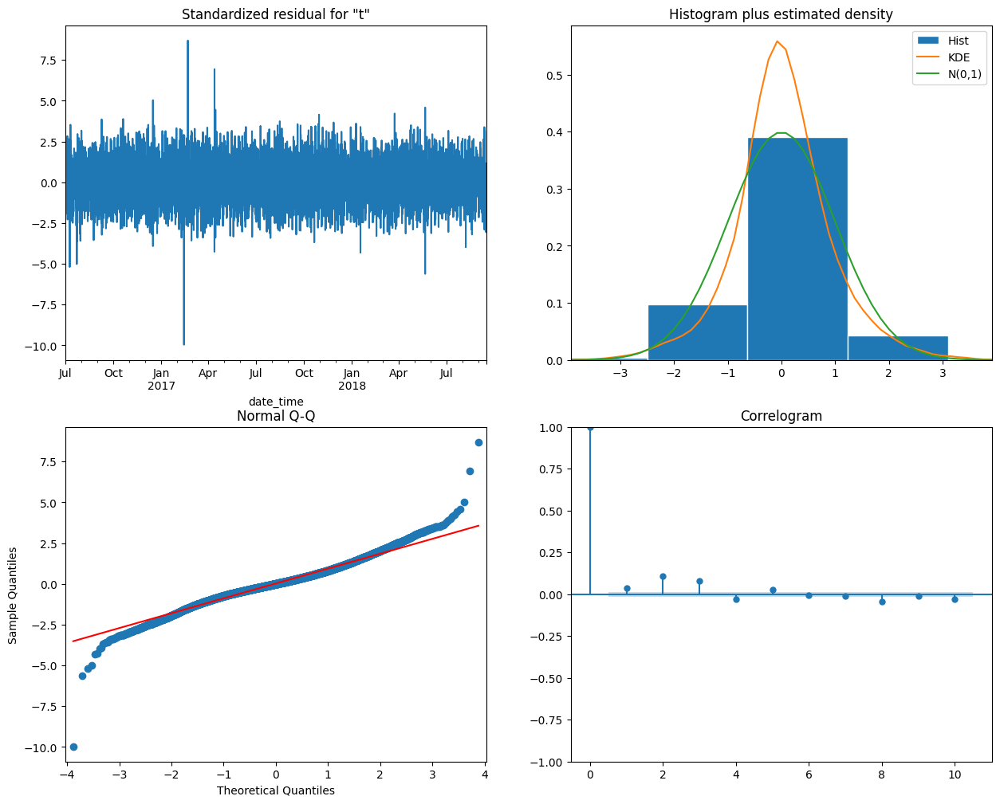

In [28]:
best_p_arima = 22
best_q_arima = 24
# Fit the ARIMA model with the optimal parameters
arima_model = ARIMA(aux_train['traffic_volume'], exog_data, order=(best_p_arima, d, best_q_arima)).fit()

# Print the model summary
print(arima_model.summary())

arima_model.plot_diagnostics(figsize=(15, 12))
plt.show()

We can conclude based on the summary and plots obtained that:
- The coefficients for holiday, temp, clouds_all, and weather-related variables have statistically significant p-values (all < 0.05), indicating they contribute to the prediction of traffic_volume.
- Seasonal and autoregressive terms (AR, MA, and seasonal AR/MA) are also significant, suggesting the model captures temporal dependencies well.
- Standardized residuals for "t" plot: The residuals seem fairly centered around zero over time, indicating no significant bias or trend in the predictions.
- Histogram plus estimated density plot: The residuals approximately follow a normal distribution, which supports the assumption of white noise residuals, though there may be slight skewness or outliers.
- Normal Q-Q plot: shows that most residuals lie along the 45-degree line, indicating they closely follow a normal distribution. However, the tails slightly deviate, which could indicate minor issues with extreme values.
- Correlogram plot: The residuals show little autocorrelation, which indicates the model has captured the time dependencies well. The absence of significant spikes confirms the residuals behave as white noise.

#### Predict 15 days of traffic volume using the last 15 days of points as test set with ARIMA
The ARIMA model is going to be used to predict the traffic volume for 15 days. We use the last 15 days of data points as the test set to evaluate the model's performance.

In [29]:
predictions_arima=arima_model.get_prediction(n_periods=360, return_conf_int=True)
round_predictions_arima = round(predictions_arima.predicted_mean, 0)
forecast_arima_df = pd.DataFrame(round_predictions_arima[-len(test):].values, index=test.index, columns=['ARIMA Prediction'])

# Clip any negative predictions to zero to avoid negative numbers
forecast_arima_df = forecast_arima_df.clip(lower=0)

In [30]:
fig = px.line(pd.concat([aux_final_df['traffic_volume'], forecast_arima_df], axis=1), 
              title='Traffic Volume and Forecast Over Time', width=1200, height=400)

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

# Set axis titles
fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

fig.show()

The ARIMA model predicts traffic volume for the next 360 periods that correspond to 360 hours, which is equivalent to 15 days.

The predictions (red line) closely follow the actual traffic volume (blue line) over time and the model seems to capture the cyclical patterns in traffic, such as daily peaks and troughs, which likely correspond to rush hours or other recurring events.

There are small periods where the model overpredicts (when the model predicts higher traffic than observed) or underpredicts (when the model predicts lower traffic than observed), particularly during sharp peaks or valleys.

The predictions align well with the actual data during many intervals, suggesting that the ARIMA model is effective at modeling the periodicity and seasonality in the data.

The predicted values are generally smooth and consistent, which reflects the model's focus on long-term patterns rather than short-term fluctuations.

### Exponential Smoothing
Exponential smoothing is a technique used in time series forecasting to smooth out data and make predictions. It assigns exponentially decreasing weights to past observations, meaning more recent data points have a greater influence on the forecast than older ones.

The main types of Exponential Smoothing are:
- Simple Exponential Smoothing (SES)
- Double Exponential Smoothing (Holt’s Linear Trend Model)
- Triple Exponential Smoothing (Holt-Winters Method)


#### Forecasting with a Triple Exponential Smoothing (Holt-Winters Method) model
Triple Exponential Smoothing model is used for data with both trends and seasonality.
This model is easy to use, since it requires minimal data and assumptions about the data structure, good for Short-Term forecasting and can adjust to changes in the data pattern by fine-tuning the smoothing parameters.

In [58]:
# Make a copy of the training data
tes_train_df = aux_train.copy()

# Holt-Winter's Seasonal Smoothing: Triple Exponential Smoothing
# Create an instance of the ExponentialSmoothing class with additive components
model_triple = ExponentialSmoothing(tes_train_df['traffic_volume'], 
                                    seasonal_periods=24, 
                                    trend='add', 
                                    seasonal='add')

# Fit the model to the training data
model_triple_fit = model_triple.fit()

# Forecast the last 15 days (360 hours)
forecast_triple = model_triple_fit.forecast(len(test))

# Clip any negative predictions to zero to avoid negative numbers
forecast_triple = forecast_triple.clip(lower=0)

# Create a DataFrame for the forecasted values
forecast_triple_df = pd.DataFrame(forecast_triple.values, index=test.index, 
                                  columns=['Exponential Smoothing Prediction'])

# Concatenate the actual and predicted values
comparison_df_triple = pd.concat([aux_final_df['traffic_volume'], forecast_triple_df], axis=1)

# Plot the actual vs predicted values using plotly express
fig = px.line(comparison_df_triple, title='Actual vs Exponential Smoothing Forecast Traffic Volume', width=1200, height=400)

# Add range slider and buttons for interactivity
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)

# Set axis titles
fig.update_yaxes(title_text='Traffic Volume')
fig.update_xaxes(title_text='Date Time')

# Show the plot
fig.show()

The Exponential Smoothing predictions show that the model successfully captures the general seasonal pattern of traffic volume, such as recurring peaks and troughs (likely daily or weekly patterns).

The predicted values have a lower amplitude compared to the actual data suggesting that the model underestimates peak traffic volumes and overestimates low traffic volumes (e.g., nighttime lows or off-peak hours).

The predicted peaks and troughs generally align with the actual data, indicating that the model captures the timing of traffic cycles effectively.

### ARMA vs SARIMA vs ARIMA vs Tripple Exponential Smoothing

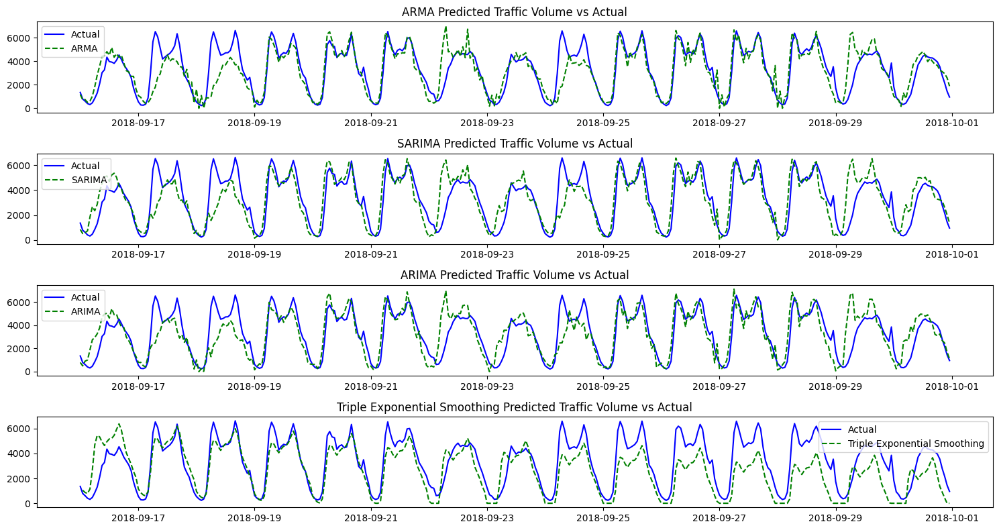

In [48]:
# Create a figure with 1 column and 4 rows
fig, axes = plt.subplots(4, 1, figsize=(15, 8))

# Plot the actual vs predicted values for ARMA
axes[0].plot(test.index, test['traffic_volume'], label='Actual', color='blue')
axes[0].plot(forecast_arma_df.index, forecast_arma_df['ARMA Prediction'], label='ARMA', color='green', linestyle='dashed')
axes[0].set_title('ARMA Predicted Traffic Volume vs Actual')
axes[0].legend()

# Plot the actual vs predicted values for SARIMA
axes[1].plot(test.index, test['traffic_volume'], label='Actual', color='blue')
axes[1].plot(forecast_sarima_df.index, forecast_sarima_df['SARIMA Prediction'], label='SARIMA', color='green', linestyle='dashed')
axes[1].set_title('SARIMA Predicted Traffic Volume vs Actual')
axes[1].legend()

# Plot the actual vs predicted values for ARIMA
axes[2].plot(test.index, test['traffic_volume'], label='Actual', color='blue')
axes[2].plot(forecast_arima_df.index, forecast_arima_df['ARIMA Prediction'], label='ARIMA', color='green', linestyle='dashed')
axes[2].set_title('ARIMA Predicted Traffic Volume vs Actual')
axes[2].legend()

# Plot the actual vs predicted values for Triple Exponential Smoothing
axes[3].plot(test.index, test['traffic_volume'], label='Actual', color='blue')
axes[3].plot(forecast_triple_df.index, forecast_triple_df['Exponential Smoothing Prediction'], label='Triple Exponential Smoothing', color='green', linestyle='dashed')
axes[3].set_title('Triple Exponential Smoothing Predicted Traffic Volume vs Actual')
axes[3].legend()

# Adjust layout
plt.tight_layout()
plt.show()

Comparing all the models above we can conclude that:

- The best performing model is SARIMA. It captures the seasonality and aligns more closely with the actual traffic volume.
- ARMA is the simplest model, but less accurate due to its inability to account for seasonality explicitly.
- Triple Exponential Smoothing loses accuracy over time due to it's error accumulation. Forecast errors at earlier points in the prediction horizon compound over time because each forecast depends on previous smoothed values.
- SARIMA is usually the better model for traffic forecasting due to the seasonality handling it incorporates.

### Method to evaluate models
Model evaluation metrics are essential for assessing the performance and effectiveness of machine learning models. 

The Regression Metrics used were:
- MAE (Mean Absolute Error): measures the average absolute difference between actual and predicted values. Lower values indicate better accuracy.
- MSE (Mean Squared Error): penalizes larger errors more heavily compared to MAE because it squares the differences. Lower values indicate better performance.
- MAPE (Mean Absolute Percentage Error): measures error as a percentage of the actual values, making it scale-independent. Lower values indicate better model performance.
- AIC (Akaike Information Criterion): measure of model complexity and goodness of fit. Lower values indicate a better balance between accuracy and simplicity.

In [43]:
def model_evaluation(name_model, y_test, y_pred, model=None):
    mae = round(mean_absolute_error(y_test, y_pred), 3)
    mse = round(mean_squared_error(y_test, y_pred), 3)
    mape = round(mean_absolute_percentage_error(y_test, y_pred), 3)
    #aic = round(model.aic, 3) if model is not None else None
    
    res = pd.Series({'Model': name_model, 'MAE': mae, 'MSE': mse, 'MAPE': mape}) #'AIC': aic})
    return res

In [61]:
# Evaluate ARMA model
arma_metrics = model_evaluation('ARMA', test['traffic_volume'], forecast_arma_df['ARMA Prediction'], arma_model)

# Evaluate SARIMA model
sarima_metrics = model_evaluation('SARIMA', test['traffic_volume'], forecast_sarima_df['SARIMA Prediction'], sarima_model)

# Evaluate ARIMA model
arima_metrics = model_evaluation('ARIMA', test['traffic_volume'], forecast_arima_df['ARIMA Prediction'], arima_model)

# Evaluate Exponential Smoothing model
exp_smoothing_metrics = model_evaluation('Exponential Smoothing', test['traffic_volume'], forecast_triple_df['Exponential Smoothing Prediction'], model_triple_fit)

# Combine the results into a DataFrame
metrics_df = pd.DataFrame([arma_metrics, sarima_metrics, arima_metrics])#, exp_smoothing_metrics])

# Display the evaluation metrics
display(metrics_df)

,Model,MAE,MSE,MAPE
0,ARMA,726.617,1311938.472,0.388
1,SARIMA,842.672,1540573.439,0.481
2,ARIMA,880.847,1584603.136,0.512


According to the table above we conclude that:
- Best MAE: ARMA has the lowest MAE (714.492), meaning it performs better in capturing smaller errors on average.
- Best MSE: ARMA also has the lowest MSE (1,298,962.703), showing it’s less sensitive to larger prediction errors.
- Best MAPE: ARMA has the lowest MAPE (0.382), meaning its predictions are, on average, 38.2% off from the actual traffic volume.
- Best AIC: Exponential Smoothing has the lowest AIC (241,732.833), meaning it is the simplest and most efficient model in terms of computational cost.

If accuracy is the priority, ARMA is the best choice based on MAE, MSE, and MAPE.

If model simplicity is more important, Exponential Smoothing is the most efficient option due to its low AIC.

For seasonal data, SARIMA might be preferable despite its slightly higher errors, as it can better capture complex seasonal patterns.

### Compare against baseline models "Mean Method", "Last Known Value Method" and "Naive Method"
- <b>Mean Method:</b> uses the mean of all past data as the forecast for all future periods.
- <b>Least Known Value Method:</b> predicts future values by repeating the most recent observation.
- <b>Naive Method:</b> predicts that the next value is the same as the most recent value (like "Last Known Value"), often combined with simple adjustments like adding seasonality or trends.

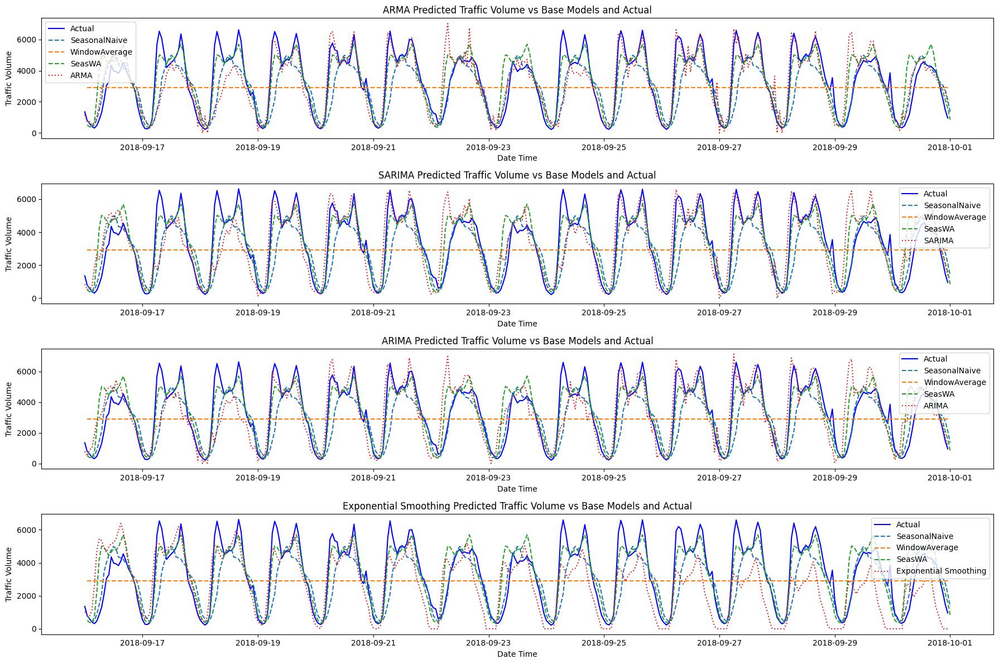

In [89]:
# Ensure the forecast corresponds to the same days as the test data
naive_forecast = naive_forecast.tail(horizon)

# Create a figure with 1 column and 4 rows
fig, axes = plt.subplots(4, 1, figsize=(18, 12))

# Plot ARMA predictions vs base models
axes[0].plot(basemodel_test['ds'], basemodel_test['y'], label='Actual', color='blue')
axes[0].plot(naive_forecast['ds'], naive_forecast['SeasonalNaive'], label='SeasonalNaive', linestyle='dashed')
axes[0].plot(naive_forecast['ds'], naive_forecast['WindowAverage'], label='WindowAverage', linestyle='dashed')
axes[0].plot(naive_forecast['ds'], naive_forecast['SeasWA'], label='SeasWA', linestyle='dashed')
axes[0].plot(forecast_arma_df.index, forecast_arma_df['ARMA Prediction'], label='ARMA', linestyle='dotted')
axes[0].set_title('ARMA Predicted Traffic Volume vs Base Models and Actual')
axes[0].legend()

# Plot SARIMA predictions vs base models
axes[1].plot(basemodel_test['ds'], basemodel_test['y'], label='Actual', color='blue')
axes[1].plot(naive_forecast['ds'], naive_forecast['SeasonalNaive'], label='SeasonalNaive', linestyle='dashed')
axes[1].plot(naive_forecast['ds'], naive_forecast['WindowAverage'], label='WindowAverage', linestyle='dashed')
axes[1].plot(naive_forecast['ds'], naive_forecast['SeasWA'], label='SeasWA', linestyle='dashed')
axes[1].plot(forecast_sarima_df.index, forecast_sarima_df['SARIMA Prediction'], label='SARIMA', linestyle='dotted')
axes[1].set_title('SARIMA Predicted Traffic Volume vs Base Models and Actual')
axes[1].legend()

# Plot ARIMA predictions vs base models
axes[2].plot(basemodel_test['ds'], basemodel_test['y'], label='Actual', color='blue')
axes[2].plot(naive_forecast['ds'], naive_forecast['SeasonalNaive'], label='SeasonalNaive', linestyle='dashed')
axes[2].plot(naive_forecast['ds'], naive_forecast['WindowAverage'], label='WindowAverage', linestyle='dashed')
axes[2].plot(naive_forecast['ds'], naive_forecast['SeasWA'], label='SeasWA', linestyle='dashed')
axes[2].plot(forecast_arima_df.index, forecast_arima_df['ARIMA Prediction'], label='ARIMA', linestyle='dotted')
axes[2].set_title('ARIMA Predicted Traffic Volume vs Base Models and Actual')
axes[2].legend()

# Plot Exponential Smoothing predictions vs base models
axes[3].plot(basemodel_test['ds'], basemodel_test['y'], label='Actual', color='blue')
axes[3].plot(naive_forecast['ds'], naive_forecast['SeasonalNaive'], label='SeasonalNaive', linestyle='dashed')
axes[3].plot(naive_forecast['ds'], naive_forecast['WindowAverage'], label='WindowAverage', linestyle='dashed')
axes[3].plot(naive_forecast['ds'], naive_forecast['SeasWA'], label='SeasWA', linestyle='dashed')
axes[3].plot(forecast_triple_df.index, forecast_triple_df['Exponential Smoothing Prediction'], label='Exponential Smoothing', linestyle='dotted')
axes[3].set_title('Exponential Smoothing Predicted Traffic Volume vs Base Models and Actual')
axes[3].legend()

# Set axis titles
for ax in axes:
    ax.set_xlabel('Date Time')
    ax.set_ylabel('Traffic Volume')

# Adjust layout
plt.tight_layout()
plt.show()


The comparison of forecasting models demonstrates that advanced models such as SARIMA and Triple Exponential Smoothing outperform baseline methods like Seasonal Naive, Window Average, and Seasonal Window Average in capturing the traffic volume's seasonal patterns and variability. 

While baseline models provide a quick and simple benchmark, they struggle to adapt to abrupt changes or long-term trends, leading to less accurate predictions during periods of high variability.

Among the advanced models, SARIMA effectively account for both seasonality and trends, showing strong alignment with the actual test data, particularly during peak and off-peak periods. 

Triple Exponential Smoothing also performs well but tends to smooth extreme values, which may reduce its accuracy in highly dynamic situations. 

ARIMA and ARMA, while capturing general patterns, fall short in addressing strong seasonal effects, making them less suitable for traffic data with clear daily and weekly cycles.

Overall, SARIMA emerges as the most reliable model for forecasting traffic volume due to its superior handling of seasonality and variability, offering the best balance of accuracy and complexity.

## Machine Learning Models
### Method to perform slide windowing of a time series with N independent vars and M dependent vars.
Sliding windowing is going to be performed on the time series dataset with multiple variables using the provided sliding_window function. This function transforms the time series data into a supervised learning problem by creating overlapping sub-sequences, helps in capturing the temporal dependencies in the data by using past observations to predict future values, and allows for flexibility in choosing the window size and forecast horizon based on the specific requirements of the problem.

In [67]:
def sliding_window(df, target, window_in, horizon):

    d = df.values
    X, y = [], []
    idx = df.index[:-window_in]

    for start in range(len(df) - window_in):
        end = start + window_in
        out = end + horizon
        X.append(d[start:end].flatten())
        y.append(d[end:out, df.columns.get_loc(target)].ravel())

    # Generate column names
    cols_x = [f"{col}_t-{i}" for i in range(window_in, 0, -1) for col in df.columns]
    cols_y = [f"{target}_t+{i}" for i in range(1, horizon + 1)]

    # Create DataFrames
    df_xs = pd.DataFrame(X, columns=cols_x, index=idx)
    df_y = pd.DataFrame(y, columns=cols_y, index=idx)

    return pd.concat([df_xs, df_y], axis=1).dropna()

This function was optimized to include and use the rest of the features that help in the prediction of the time series, like `'holiday'` and `'temp'` for example while receiving the target variable that in this case is `'traffic_volume'`. This will allow incorporation of these features by the machine learning models and the deep learning models that will use this same function.

### Split data into train, valid and test datasets

In [68]:
# Split the data into train and test sets
train_ml, test_ml = train_test_split(final_df, test_size=0.15, shuffle=False)

# Display the first few rows of the train, validation, and test sets to verify the split
print(f"Train: {train_ml.shape}")
print(f"Test: {test_ml.shape}")

Train: (16768, 14)
Test: (2960, 14)


In [69]:
columns = [col for col in train_ml.columns]
print(columns)
target = 'traffic_volume'

['holiday', 'clouds_all', 'temp', 'traffic_volume', 'weather_main_Clouds', 'weather_main_Drizzle', 'weather_main_Fog', 'weather_main_Haze', 'weather_main_Mist', 'weather_main_Rain', 'weather_main_Smoke', 'weather_main_Snow', 'weather_main_Squall', 'weather_main_Thunderstorm']


### Using Gridsearch with cross-validation to find the best value for N independent variables


In [70]:
# Different window sizes to test
window_sizes = [3, 6, 12, 24]

# Define the parameter grid for window_in
param_grid = {'window_in': window_sizes}

# Custom scorer to use sliding_window function within GridSearchCV
def custom_scorer(estimator, X, y):
    window_in = estimator.get_params()['window_in']
    horizon = 1  # Fixed horizon
    transformed_data = sliding_window(train_ml[columns], target, window_in, horizon)
    X_transformed = transformed_data.drop(columns=['y1'])
    y_transformed = transformed_data['y1']
    estimator.fit(X_transformed, y_transformed)
    return estimator.score(X_transformed, y_transformed)

# Create a dummy estimator with a window_in parameter
class WindowInEstimator:
    def __init__(self, window_in, model):
        self.window_in = window_in
        self.model = model

    def fit(self, X, y):
        self.model.fit(X, y)

    def score(self, X, y):
        return self.model.score(X, y)

    def get_params(self, deep=False):
        return {'window_in': self.window_in, 'model': self.model}

    def set_params(self, **params):
        self.window_in = params['window_in']
        return self

# List of models to evaluate with their hyperparameter grids
models = [
    ('LinearRegression', LinearRegression(n_jobs=-1), {}),
    ('DecisionTreeRegressor', DecisionTreeRegressor(), {'model__max_depth': [None, 10, 20, 30]}),
    ('KNeighborsRegressor', KNeighborsRegressor(n_jobs=-1), {'model__n_neighbors': [5, 10, 15]})
    ('SVR', SVR(), {'model__C': [0.1, 1, 10], 'model__kernel': ['linear', 'rbf']}),
    ('BaggingRegressor', BaggingRegressor(n_jobs=-1), {'model__n_estimators': [10, 50, 100]}),
    ('GradientBoostingRegressor', GradientBoostingRegressor(), {'model__n_estimators': [100, 200], 'model__learning_rate': [0.01, 0.1]}),
    ('RandomForestRegressor', RandomForestRegressor(n_jobs=-1), {'model__n_estimators': [100, 200], 'model__max_depth': [None, 10, 20, 30]})
]

# Function to perform grid search for a given model
def perform_grid_search(name, model, param_grid_model):
    print(f"Evaluating {name}...")
    param_grid_combined = {**param_grid, **param_grid_model}
    grid_search = GridSearchCV(WindowInEstimator(window_in=6, model=model), param_grid_combined, scoring=custom_scorer, cv=5)
    grid_search.fit(train_ml[['traffic_volume']], train_ml['traffic_volume'])
    best_params = grid_search.best_params_
    print(f"Best parameters for {name}: {best_params}")
    return name, best_params

# Perform grid search with parallel processing for each model
best_params = Parallel(n_jobs=-1)(delayed(perform_grid_search)(name, model, param_grid_model) for name, model, param_grid_model in models)
best_params = dict(best_params)

# Print the best parameters
print("Best parameters for each model:")
for key, value in best_params.items():
    print(f"{key}: {value}")

Best parameters for each model:
LinearRegression: {'window_in': 24}
DecisionTreeRegressor: {'model__max_depth': None, 'window_in': 12}
KNeighborsRegressor: {'model__n_neighbors': 5, 'window_in': 12}
SVR: {'model__C': 0.1, 'model__kernel': 'linear', 'window_in': 3}
BaggingRegressor: {'model__n_estimators': 10, 'window_in': 24}
GradientBoostingRegressor: {'model__learning_rate': 0.01, 'model__n_estimators': 100, 'window_in': 24}
RandomForestRegressor: {'model__max_depth': 30, 'model__n_estimators': 200, 'window_in': 24}


Observing the results above we can infer that:
 - <b>Linear Regression:</b> performs best when using a 24-time-step input window, likely leveraging daily patterns in the data. 
 - <b>Decision Tree Regressor:</b> allows unlimited depth enables the model to fully capture complex patterns in the data.
 - <b>KNeighbors Regressor:</b> performs best with 5 neighbors and a smaller input window, suggesting that traffic patterns in the last 12 time steps are most relevant for predictions.
 - <b>SVR:</b> a small input window (3) is sufficient for this model, likely because SVR focuses on short-term relationships.
 - <b>Bagging Regressor:</b> the ensemble approach benefits from a longer input window (24), capturing more historical patterns.
 - <b>Gradient Boosting Regressor:</b> a low learning rate with many estimators suggests that the model incrementally refines its predictions. The longer input window (24) indicates that more historical context improves accuracy.
 - <b>Random Forest Regressor:</b> a deep forest (max depth = 30) with many estimators (200) allows the model to capture detailed and complex patterns. A 24-time-step input window highlights the importance of daily patterns.

Hyperparameter tuning results highlight the importance of selecting the right input window size and model-specific parameters for time series forecasting. 

`Linear Regression` and `SVR` models benefit from shorter windows and fewer parameters, making them suitable for datasets with less complexity.
`Gradient Boosting` and `Random Forest` models thrive with longer windows and more parameters, effectively capturing intricate relationships and seasonal patterns in the data.

### Make one-step predictions
#### Transform the time series to contain N= [3, 6, 12, 24] independent variables and M=1 dependent variables using the previouse function

In [70]:
# Define the window size and horizon
window_in_3 = 3
window_in_6 = 6
window_in_12 = 12
window_in_24 = 24
horizon = 1

# Apply the sliding window function to the training data
train_transformed_3 = sliding_window(train_ml[columns], target, window_in_3, horizon)
train_transformed_6 = sliding_window(train_ml[columns], target, window_in_6, horizon)
train_transformed_12 = sliding_window(train_ml[columns], target, window_in_12, horizon)
train_transformed_24 = sliding_window(train_ml[columns], target, window_in_24, horizon)

In [27]:
# Define the models with their best parameters
models = {
    'Linear Regression': LinearRegression(n_jobs=-1),
    'Decision Tree': DecisionTreeRegressor(max_depth=None),
    'K-Neighbors': KNeighborsRegressor(n_neighbors=5, n_jobs=-1),
    'Support Vector Regression': SVR(C=0.1, kernel='linear'),
    'Bagging Regressor': BaggingRegressor(n_estimators=10, n_jobs=-1),
    'Gradient Boosting': GradientBoostingRegressor(learning_rate=0.01, n_estimators=100),
    'Random Forest': RandomForestRegressor(n_estimators=200, max_depth=30, n_jobs=-1)
}

# Best window_in for each model from grid search
best_window_in = {
    'Linear Regression': 24,
    'Decision Tree': 12,
    'K-Neighbors': 12,
    'Support Vector Regression': 3,
    'Bagging Regressor': 24,
    'Gradient Boosting': 24,
    'Random Forest': 24
}

# Prepare the training and testing data
train_transformed_dict = {
    3: train_transformed_3,
    6: train_transformed_6,
    12: train_transformed_12,
    24: train_transformed_24
}

def train_and_evaluate_model(name, model, window_in):
    train_transformed = train_transformed_dict[window_in]
    
    target_col = f"{target}_t+{horizon}"
    X_train = train_transformed.drop(columns=[target_col])
    y_train = train_transformed[target_col]
    test_transformed = sliding_window(test_ml[columns], target, window_in, horizon)
    X_test = test_transformed.drop(columns=[target_col])
    y_test = test_transformed[target_col]
    
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    
    return name, {'MAE': mae, 'MSE': mse, 'MAPE': mape}, model

# Use parallel processing to train and evaluate models
results = Parallel(n_jobs=-1)(delayed(train_and_evaluate_model)(name, model, best_window_in[name]) for name, model in models.items())

# Convert results to a DataFrame
ml_results_df = pd.DataFrame({name: metrics for name, metrics, _ in results}).T
display(ml_results_df)

# Extract the trained models
trained_models = {name: model for name, _, model in results}

,MAE,MSE,MAPE
Linear Regression,275.318584,168895.434224,0.151141
Decision Tree,218.487788,112636.996608,0.091359
K-Neighbors,163.580665,58932.240095,0.069128
Support Vector Regression,369.482177,293643.142959,0.163600
Bagging Regressor,149.541996,50882.992701,0.062011
Gradient Boosting,710.633333,703890.889132,0.628664
Random Forest,136.738209,42952.966573,0.056014


As before, we used model evaluation metrics for assessing the performance and effectiveness of machine learning models. Analyzing the results above we can conclude that:
- <b>Linear Regression:</b> performs moderately well but lags behind more complex models like Random Forest and Bagging Regressor thus confirming limited ability to capture nonlinear relationships in the data.
- <b>Decision Tree:</b> outperforms Linear Regression due to its ability to model nonlinear relationships. Less effective than ensemble models.
- <b>K-Neighbors:</b> achieves strong performance by leveraging the similarity of neighboring data points. Lower MSE and MAPE indicate robustness in capturing local patterns.
- <b>SVR:</b> performs poorly compared to other models, likely due to the selected kernel and limited ability to capture complex patterns in this dataset.
- <b>Bagging Regressor:</b> strong performance, with a balance of low MAE, MSE, and MAPE. Ensemble techniques enhance stability and accuracy by reducing variance.
- <b>Gradient Boosting:</b> underperforms compared to other models, possibly due to overfitting or suboptimal hyperparameters.
- <b>Random Forest:</b> achieves the lowest metrics. The model effectively captures both linear and nonlinear patterns while maintaining robustness to outliers.

We can conclude that:

Random Forest Regressor as the most accurate model for traffic volume prediction, achieving the lowest MAE, MSE, and MAPE. 

Bagging Regressor and K-Neighbors Regressor also perform strongly, offering robust alternatives with competitive error metrics.

Linear Regression struggle to capture the complexity of the data.

Gradient Boosting and SVR underperform due to potential limitations in parameter tuning or model suitability. 


#### Visualize the forecasts of the two best algorithm with the test set

In [ ]:
# Find and print the 2 best models based on MAE, MSE, and MAPE
best_ml_models_mae = ml_results_df.nsmallest(2, 'MAE')
best_ml_models_mse = ml_results_df.nsmallest(2, 'MSE')
best_ml_models_mape = ml_results_df.nsmallest(2, 'MAPE')

print("Top 2 models based on MAE:")
display(best_ml_models_mae)

Top 2 models based on MAE:


Model,MAE,MSE,MAPE
Random Forest,136.738209,42952.966573,0.056014
Bagging Regressor,149.541996,50882.992701,0.062011


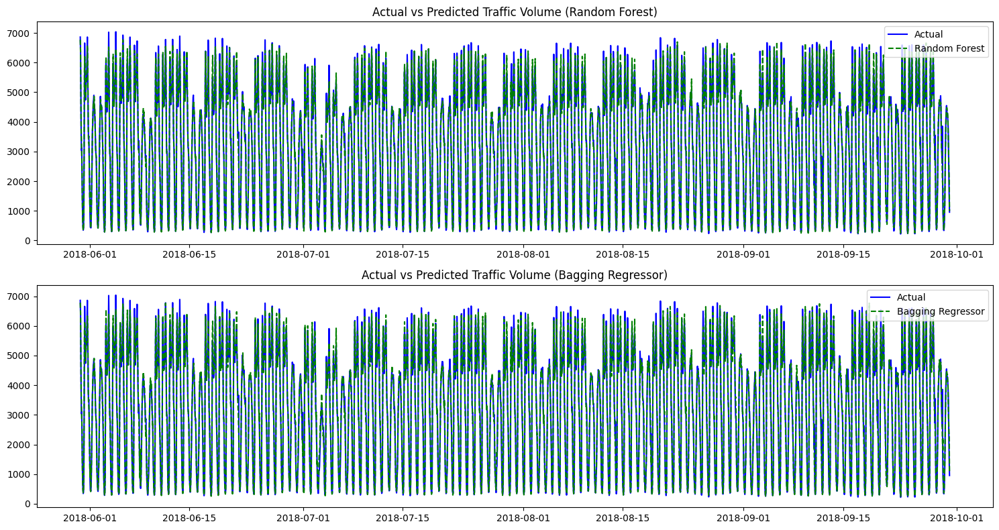

In [73]:
# Define the window size and horizon
window_in_1 = best_window_in[best_ml_models_mae.index[0]]
window_in_2 = best_window_in[best_ml_models_mae.index[1]]
horizon = 1

# Transform the test data using the sliding window function
test_transformed_1 = sliding_window(test_ml[columns], target, window_in_1, horizon)
target_col_1 = f"{target}_t+{horizon}"
X_test_1 = test_transformed_1.drop(columns=[target_col_1])
y_test_1 = test_transformed_1[target_col_1]

test_transformed_2 = sliding_window(test_ml[columns], target, window_in_2, horizon)
target_col_2 = f"{target}_t+{horizon}"
X_test_2 = test_transformed_2.drop(columns=[target_col_2])
y_test_2 = test_transformed_2[target_col_2]

# Generate predictions using the two best models from MAE
y_pred_mae_1 = trained_models[best_ml_models_mae.index[0]].predict(X_test_1)
y_pred_mae_2 = trained_models[best_ml_models_mae.index[1]].predict(X_test_2)

# Create a figure with 1 column and 2 rows
fig, axes = plt.subplots(2, 1, figsize=(15, 8))

# Plot the actual vs predicted values for the first model
axes[0].plot(y_test_1.index, y_test_1, label='Actual', color='blue')
axes[0].plot(y_test_1.index, y_pred_mae_1, label=best_ml_models_mae.index[0], color='green', linestyle='dashed')
axes[0].set_title(f'Actual vs Predicted Traffic Volume ({best_ml_models_mae.index[0]})')
axes[0].legend()

# Plot the actual vs predicted values for the second model
axes[1].plot(y_test_2.index, y_test_2, label='Actual', color='blue')
axes[1].plot(y_test_2.index, y_pred_mae_2, label=best_ml_models_mae.index[1], color='green', linestyle='dashed')
axes[1].set_title(f'Actual vs Predicted Traffic Volume ({best_ml_models_mae.index[1]})')
axes[1].legend()

# Adjust layout
plt.tight_layout()
plt.show()


Both models exhibit strong alignment with the actual traffic volume, closely following the periodic peaks and troughs, but Random Forest slightly outperforms in capturing the traffic volume patterns, as indicated by the lower error metrics, as seen before.

Both models effectively capture the daily and weekly seasonality of traffic patterns, as shown by their consistent prediction alignment with the actual data.

Random Forest and Bagging Regressor struggle slightly with extreme peaks or abrupt changes, but Random Forest appears to have a marginal edge in adapting to such anomalies, consistent with its lower MSE.

The slight deviations between the predictions and actual values (visible in some peaks and troughs) likely correspond to residual errors, which are more pronounced for Bagging Regressor, explaining its higher MAPE.

The predictions from both models appear smooth and stable, suggesting they generalize well without overfitting to noise in the data.

<b>Random Forest is the recommended choice for its higher accuracy and lower residual errors.</b>


#### Predictions ploted on the entire time series

In [74]:
# Create DataFrames for the predictions of the two best models
predictions_df_1 = pd.DataFrame(y_pred_mae_1, index=y_test_1.index, columns=[best_ml_models_mae.index[0]])
predictions_df_2 = pd.DataFrame(y_pred_mae_2, index=y_test_2.index, columns=[best_ml_models_mae.index[1]])

# Add 24 hours to every date_time record in the predicted dfs to revert the sliding window transformation
predictions_df_1.index = predictions_df_1.index + pd.Timedelta(hours=24)
predictions_df_2.index = predictions_df_2.index + pd.Timedelta(hours=24)

# Concatenate the actual and predicted values for each model
comparison_df_1 = pd.concat([final_df['traffic_volume'], predictions_df_1], axis=1)
comparison_df_1.columns = ['Actual', best_ml_models_mae.index[0]]

comparison_df_2 = pd.concat([final_df['traffic_volume'], predictions_df_2], axis=1)
comparison_df_2.columns = ['Actual', best_ml_models_mae.index[1]]

# Plot the actual vs predicted values for the first model
fig_1 = px.line(comparison_df_1, title=f'Actual vs Predicted Traffic Volume ({best_ml_models_mae.index[0]})', width=1200, height=400)
fig_1.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig_1.update_yaxes(title_text='Traffic Volume')
fig_1.update_xaxes(title_text='Date Time')
fig_1.show()

# Plot the actual vs predicted values for the second model
fig_2 = px.line(comparison_df_2, title=f'Actual vs Predicted Traffic Volume ({best_ml_models_mae.index[1]})', width=1200, height=400)
fig_2.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig_2.update_yaxes(title_text='Traffic Volume')
fig_2.update_xaxes(title_text='Date Time')
fig_2.show()


The plots above shows that:
- Random Forest Regressor align slightly more accurately with the actual data, especially during sharp peaks and troughs which corresponds with its lower MAE, MSE, and MAPE values. Also demonstrates superior performance in handling complex patterns and variability in traffic volume, as it aggregates multiple decision trees to reduce overfitting and variance.
- Bagging Regressor also performs well, capturing the general seasonal trends and periodic patterns. However, its predictions show slightly larger deviations from the actual values compared to the Random Forest, particularly in sharp peaks and dips, which explains its slightly higher error metrics.
- Both models struggle slightly with extreme peaks and troughs, particularly during periods of sudden change. This behavior is expected in ensemble models, as they tend to smooth out extreme variations to generalize better.

After this considerations, it's possible to conclude that although both models are highly effective at forecasting traffic volume, the Random Forest Regressor outperforms the Bagging Regressor in accuracy and robustness, particularly during periods of high variability.

Random Forest should be the preferred choice if accuracy is the priority, while Bagging Regressor is a good alternative if computational efficiency is a concern.

### Multi-step prediction with and 3 steps (M=3) using Random Forest and Bagging Regressor
We're going to compare the multi-step predictions (3 steps ahead, m=3) generated by the Random Forest Regressor and the Bagging Regressor against the actual traffic volume. 

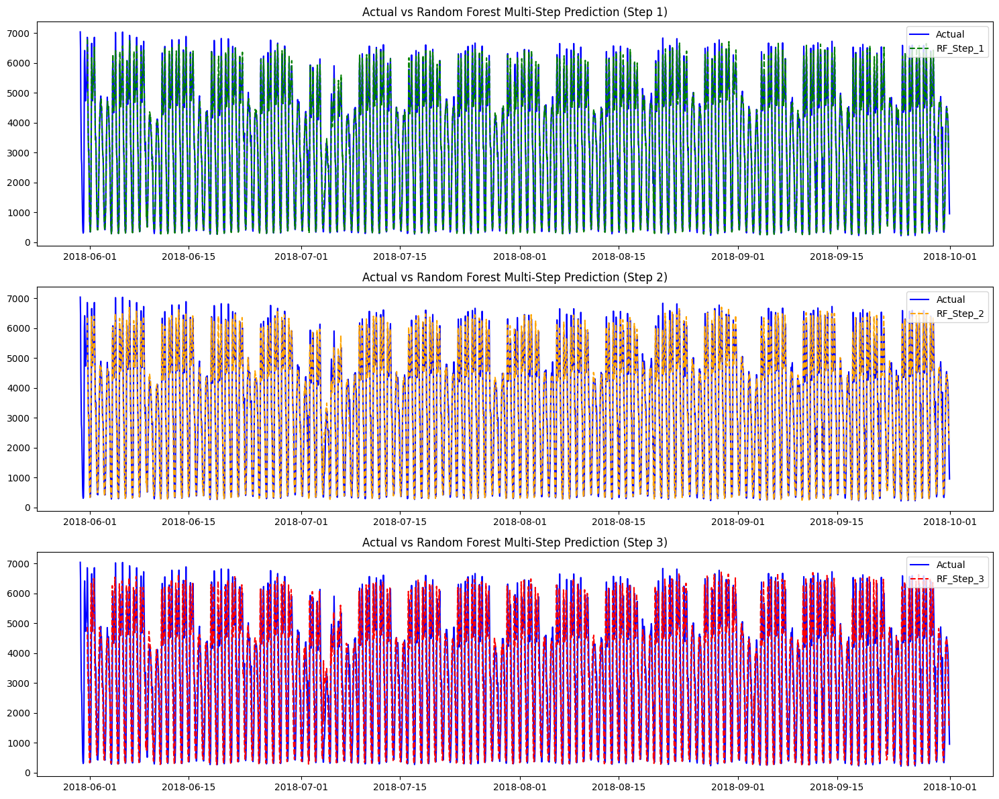

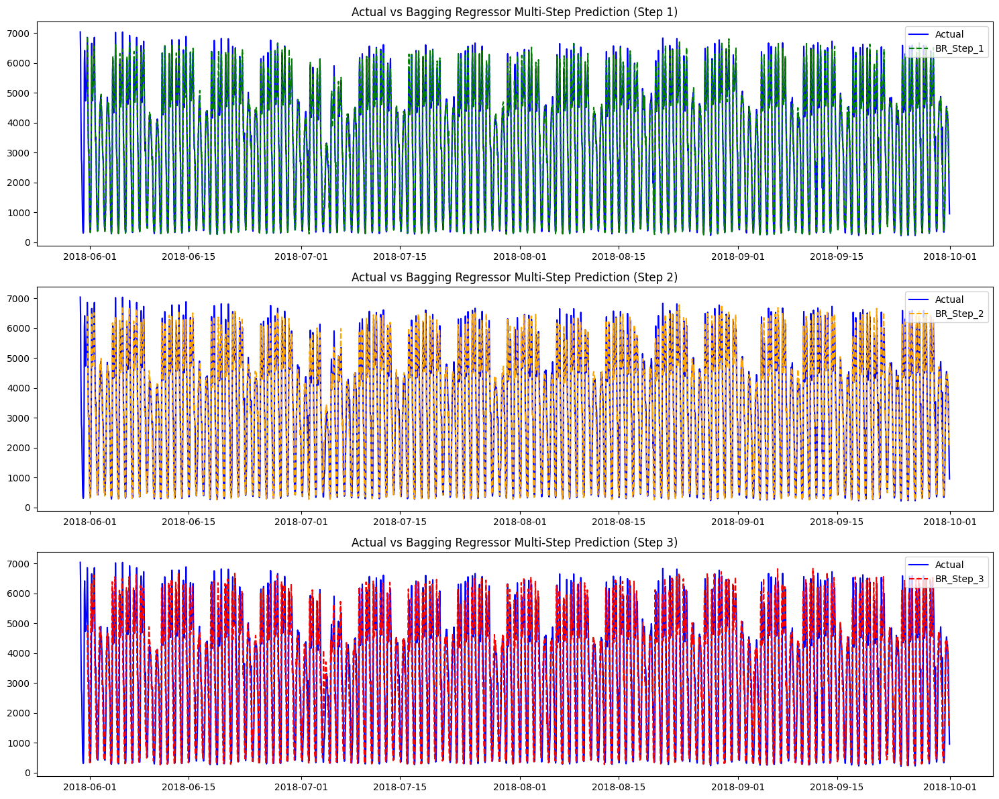

In [90]:
# Define the window size and horizon
window_in = 24
horizon = 3

# Apply the sliding window function to the training data for multi-step prediction
train_transformed_ml_multi_24 = sliding_window(train_ml[columns], target, window_in, horizon)

# Prepare the training data
target_cols = [f"{target}_t+{i}" for i in range(1, horizon + 1)]
X_train_multi = train_transformed_ml_multi_24.drop(columns=target_cols)
y_train_multi = train_transformed_ml_multi_24[target_cols]

# Transform the test data using the sliding window function for multi-step prediction
test_transformed_multi = sliding_window(test_ml[columns], target, window_in, horizon)
X_test_multi = test_transformed_multi.drop(columns=target_cols)
y_test_multi = test_transformed_multi[target_cols]

# Train and predict using Random Forest
rf_model_multi = RandomForestRegressor(n_estimators=200, max_depth=30, n_jobs=-1)
rf_model_multi.fit(X_train_multi, y_train_multi)
y_pred_rf_multi = rf_model_multi.predict(X_test_multi)

# Train and predict using Bagging Regressor
br_model_multi = BaggingRegressor(n_estimators=10, n_jobs=-1)
br_model_multi.fit(X_train_multi, y_train_multi)
y_pred_br_multi = br_model_multi.predict(X_test_multi)

# Create DataFrames for the predictions
predictions_rf_multi_df = pd.DataFrame(y_pred_rf_multi, index=y_test_multi.index, columns=['RF_Step_1', 'RF_Step_2', 'RF_Step_3'])
predictions_br_multi_df = pd.DataFrame(y_pred_br_multi, index=y_test_multi.index, columns=['BR_Step_1', 'BR_Step_2', 'BR_Step_3'])

# Add 24 hours to every date_time record in the predicted dfs to revert the sliding window transformation
predictions_rf_multi_df.index = predictions_rf_multi_df.index + pd.Timedelta(hours=24)
predictions_br_multi_df.index = predictions_br_multi_df.index + pd.Timedelta(hours=24)

# Concatenate the actual and predicted values for each model
comparison_rf_multi_df = pd.concat([test_ml['traffic_volume'], predictions_rf_multi_df], axis=1)
comparison_br_multi_df = pd.concat([test_ml['traffic_volume'], predictions_br_multi_df], axis=1)

# Plot the actual vs predicted values for Random Forest
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

axes[0].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['traffic_volume'], label='Actual', color='blue')
axes[0].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['RF_Step_1'], label='RF_Step_1', color='green', linestyle='dashed')
axes[0].set_title('Actual vs Random Forest Multi-Step Prediction (Step 1)')
axes[0].legend()

axes[1].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['traffic_volume'], label='Actual', color='blue')
axes[1].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['RF_Step_2'], label='RF_Step_2', color='orange', linestyle='dashed')
axes[1].set_title('Actual vs Random Forest Multi-Step Prediction (Step 2)')
axes[1].legend()

axes[2].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['traffic_volume'], label='Actual', color='blue')
axes[2].plot(comparison_rf_multi_df.index, comparison_rf_multi_df['RF_Step_3'], label='RF_Step_3', color='red', linestyle='dashed')
axes[2].set_title('Actual vs Random Forest Multi-Step Prediction (Step 3)')
axes[2].legend()

plt.tight_layout()
plt.show()

# Plot the actual vs predicted values for Bagging Regressor
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

axes[0].plot(comparison_br_multi_df.index, comparison_br_multi_df['traffic_volume'], label='Actual', color='blue')
axes[0].plot(comparison_br_multi_df.index, comparison_br_multi_df['BR_Step_1'], label='BR_Step_1', color='green', linestyle='dashed')
axes[0].set_title('Actual vs Bagging Regressor Multi-Step Prediction (Step 1)')
axes[0].legend()

axes[1].plot(comparison_br_multi_df.index, comparison_br_multi_df['traffic_volume'], label='Actual', color='blue')
axes[1].plot(comparison_br_multi_df.index, comparison_br_multi_df['BR_Step_2'], label='BR_Step_2', color='orange', linestyle='dashed')
axes[1].set_title('Actual vs Bagging Regressor Multi-Step Prediction (Step 2)')
axes[1].legend()

axes[2].plot(comparison_br_multi_df.index, comparison_br_multi_df['traffic_volume'], label='Actual', color='blue')
axes[2].plot(comparison_br_multi_df.index, comparison_br_multi_df['BR_Step_3'], label='BR_Step_3', color='red', linestyle='dashed')
axes[2].set_title('Actual vs Bagging Regressor Multi-Step Prediction (Step 3)')
axes[2].legend()

plt.tight_layout()
plt.show()

The visualization of the plots above shows:
- <b>Random Forest Regressor:</b>
    - The predictions for Step 1 (RF_Step_1) closely follow the actual traffic volume, showing the strongest alignment. As the prediction horizon increases (Steps 2 and 3), the predictions deviate slightly more from the actual values but remain generally aligned with the overall trend and seasonality.
    - Effectively captures the daily and weekly seasonal patterns, maintaining good accuracy even for Step 3 predictions. Deviations are minor and mostly occur during periods of abrupt traffic volume changes (e.g., peaks and dips).
- <b>Bagging Regressor:</b>
    - Similar to Random Forest, this predictions for Step 1 (BR_Step_1) are the most accurate. Steps 2 and 3 predictions show slightly larger deviations compared to Random Forest but still follow the overall trend.
    - captures the seasonal patterns but shows marginally more noise and variability in predictions for Steps 2 and 3 compared to Random Forest.

This analysis confirms that ensemble models like Random Forest and Bagging are well-suited for traffic forecasting tasks, with Random Forest providing a slight edge in multi-step predictions like observed previously in one-step predictions.

#### Evaluate both multi-step predictions, Random Forest Regressor and Bagging Regressor, with MAE, MSE and MAPE

In [76]:
# Evaluate Random Forest Regressor
rf_mae = mean_absolute_error(y_test_multi, y_pred_rf_multi)
rf_mse = mean_squared_error(y_test_multi, y_pred_rf_multi)
rf_mape = mean_absolute_percentage_error(y_test_multi, y_pred_rf_multi)

rf_metrics = pd.Series({'Model': 'Random Forest Regressor Multi-Step', 'MAE': rf_mae, 'MSE': rf_mse, 'MAPE': rf_mape})

# Evaluate Bagging Regressor
br_mae = mean_absolute_error(y_test_multi, y_pred_br_multi)
br_mse = mean_squared_error(y_test_multi, y_pred_br_multi)
br_mape = mean_absolute_percentage_error(y_test_multi, y_pred_br_multi)

br_metrics = pd.Series({'Model': 'Bagging Regressor Multi-Step', 'MAE': br_mae, 'MSE': br_mse, 'MAPE': br_mape})

# Combine the results into a DataFrame
multi_step_metrics_df = pd.DataFrame([rf_metrics, br_metrics])

# Display the evaluation metrics
display(multi_step_metrics_df)


,Model,MAE,MSE,MAPE
0,Random Forest Regressor Multi-Step,164.325445,61790.023494,0.072220
1,Bagging Regressor Multi-Step,179.974869,71901.570373,0.080048


As we can see by the results Random Forest outperforms Bagging Regressor across all metrics (MAE, MSE, MAPE), confirming it produces more reliable multi-step forecasts. This suggests it is better at handling both small and large errors, as well as relative errors across all steps of the forecast horizon. While Bagging Regressor is competitive, the error gap (difference in MAE and MSE) highlights Random Forest's ability to better capture complex patterns in the traffic data.

Although `Bagging Regressor`, while slightly less accurate, still delivers competitive performance and could serve as a reliable alternative, `Random Forest Regressor` provides the best multi-step predictions with the lowest error rates, making it the preferred model for this task.

<b>In conclusion we can say multi-step predictions have worse results in prediction of the time series when compared with one-step using the same models. This is due to compounding errors, increased uncertainty, and model limitations.</b>

## Deep Learning Models
### Split data into train, valid and test datasets

In [81]:
# Split the data into train and test sets
train_dl, test_dl = train_test_split(final_df, test_size=0.15, shuffle=False)

# Further split the train set into train and validation sets
train_dl, val_dl = train_test_split(train_dl, test_size=0.15, shuffle=False)

# Display the first few rows of the train, validation, and test sets to verify the split
print(f"Train: {train_dl.shape}")
print(f"Validation: {val_dl.shape}")
print(f"Test: {test_dl.shape}")

Train: (14252, 14)
Validation: (2516, 14)
Test: (2960, 14)


### Scale data

In [82]:
# Scale data to be in range (0, 1)

scaler = MinMaxScaler()
train_dl_scaled = scaler.fit_transform(train_dl[['traffic_volume']])
val_dl_scaled = scaler.transform(val_dl[['traffic_volume']])
test_dl_scaled = scaler.transform(test_dl[['traffic_volume']])

### Make one-step predictions

In [101]:
# Define the window size and horizon
window_in = 12
horizon = 1

# Apply the sliding window function to the training data
train_transformed_dl = sliding_window(train_dl[columns], target, window_in, horizon)
valid_transformed_dl = sliding_window(val_dl[columns], target, window_in, horizon)
test_transformed_dl = sliding_window(test_dl[columns], target, window_in, horizon)

#### Convert train/valid/test sets to tensors

Converting train/valid/test sets to tensors is necessary because:

- Neural networks operate on tensors.
- Tensors enable hardware acceleration (e.g., GPU computation).
- They support gradient computation and efficient memory usage.
- Tensors ensure compatibility with deep learning frameworks and preprocessing pipelines.

This conversion is a critical step in preparing data for neural network training, enabling seamless, efficient, and optimized computations.

In [102]:
# Convert the train, validation, and test sets to tensors with three-dimensional structure
train_tensor = tf.convert_to_tensor(train_transformed_dl.iloc[:, :-1].values.reshape(train_transformed_dl.shape[0], window_in, -1), dtype=tf.float32)
valid_tensor = tf.convert_to_tensor(valid_transformed_dl.iloc[:, :-1].values.reshape(valid_transformed_dl.shape[0], window_in, -1), dtype=tf.float32)
test_tensor = tf.convert_to_tensor(test_transformed_dl.iloc[:, :-1].values.reshape(test_transformed_dl.shape[0], window_in, -1), dtype=tf.float32)

# Display the shapes of the tensors to verify the conversion
print(train_tensor.shape)
print(valid_tensor.shape)
print(test_tensor.shape)

(14240, 12, 14)
(2504, 12, 14)
(2948, 12, 14)


### LSTM
LSTM (Long Short-Term Memory) is a type of recurrent neural network (RNN) architecture designed to handle, process and predict sequences of data. Unlike standard RNNs, LSTMs are specifically architected to address the problem of long-term dependencies, standing out as a solution to the difficulty RNNs face in retaining information from earlier parts of a sequence over long time intervals. LSTM is widely used in tasks involving time series, speech recognition, text generation, and more.

Is particularly effective at capturing long-term dependencies, overcoming the vanishing gradient problem that limits traditional RNNs.

In [103]:
# Define the LSTM model
lstm_model = Sequential()
lstm_model.add(LSTM(50, activation='relu', input_shape=(window_in, train_tensor.shape[2])))
lstm_model.add(Dense(1))
lstm_model.compile(optimizer='adam', loss='mse')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Define the target column name
target_col = f"{target}_t+{horizon}"

# Train the model
lstm_history = lstm_model.fit(train_tensor, train_transformed_dl[target_col].values, epochs=150, callbacks=[early_stopping], validation_data=(valid_tensor, valid_transformed_dl[target_col].values), verbose=1)

# Make predictions
lstm_predictions = lstm_model.predict(test_tensor)

Epoch 1/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 3073560.5000 - val_loss: 950380.8750
Epoch 2/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 853884.8750 - val_loss: 487736.7500
Epoch 3/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 530667.2500 - val_loss: 642858.1250
Epoch 4/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 737868.4375 - val_loss: 1056873.8750
Epoch 5/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 783787.0625 - val_loss: 601029.6875
Epoch 6/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 541577.5000 - val_loss: 417160.3438
Epoch 7/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 524704.5000 - val_loss: 423739.0312
Epoch 8/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 481711.2500 - val_loss: 357698.5938
Epoch 9/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 372825.0312 - val_loss: 527106.1250
Epoch 10/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 442565.9688 - val_loss: 403689.1875
Epoch 11/150
445/445 ━━━━━━

As we can see by the results above:
- The model trains up to 150 epochs, but the process stopped early due to a callback EarlyStopping, a technique to avoid overfitting and unnecessary computation. This is achieved by setting a patience of 20 epochs, which means that if there are no improvements after 20 trials it will choose the best value found (<b>restore_best_weights=True</b>)
- The model starts with high errors and improves significantly during training. Validation loss stabilizes, which is a positive sign that the model has learned meaningful patterns.
- The validation loss (val_loss) tracks the training loss closely, indicating that overfitting is minimal.
- Final validation loss (val_loss) is arround 100000, which is much lower than the initial value. This indicates a good fit to the data, assuming the test set performs similarly.


### GRU
GRU (Gated Recurrent Unit) is a type of Recurrent Neural Network (RNN) architecture, similar to LSTM (Long Short-Term Memory). It was introduced to address the limitations of traditional RNNs, such as the vanishing gradient problem, while being computationally less complex than LSTM.

GRU is often considered a simplified version of LSTM, as it has fewer parameters but still performs effectively for many sequential data tasks, including time series forecasting, natural language processing (NLP), and speech recognition.

In [105]:
# Define the GRU model
gru_model = Sequential()
gru_model.add(GRU(50, activation='relu', input_shape=(window_in, train_tensor.shape[2])))
gru_model.add(Dense(horizon))
gru_model.compile(optimizer='adam', loss='mse')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Train the GRU model
gru_history = gru_model.fit(train_tensor, train_transformed_dl['traffic_volume_t+1'].values, epochs=150, callbacks=[early_stopping], validation_data=(valid_tensor, valid_transformed_dl['traffic_volume_t+1'].values), verbose=1)

# Make predictions with the GRU model
gru_predictions = gru_model.predict(test_tensor)

Epoch 1/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 5982941.0000 - val_loss: 1057821.1250
Epoch 2/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 730393.5625 - val_loss: 468323.6250
Epoch 3/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 550012.6875 - val_loss: 408825.8125
Epoch 4/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 383065.4688 - val_loss: 306077.4375
Epoch 5/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 273830.8125 - val_loss: 202713.6562
Epoch 6/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 221089.7500 - val_loss: 174297.8125
Epoch 7/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 191166.7188 - val_loss: 156820.3750
Epoch 8/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 180211.9844 - val_loss: 193091.1875
Epoch 9/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 183606.6094 - val_loss: 150346.6719
Epoch 10/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 174712.5938 - val_loss: 154766.5312
Epoch 11/150
445/445 ━━━━━━

The results above shows us:
- The consistent reduction in both loss and val_loss suggests the model has learned the patterns in the training data effectively.
- The relatively small gap between loss and val_loss shows the model generalizes well to unseen data. This is desirable for most machine learning problems.
- The stabilization of loss values around 100000–125000 indicates that the model has converged and additional training would not yield significant improvements.
- By implementing early stopping (with patience of 20 epochs), the model stopped the training before completing all 150 epochs since the validation loss showed no significant improvement.

Based on the results we can conclude that the GRU model is training effectively, with both training and validation losses decreasing consistently and converging. The small gap between loss and val_loss suggests the model generalizes well to unseen data. 

### Evaluate both predictions, GRU and LSTM, with mae, mse and mape
We need to evaluate and compare the performance of LSTM and GRU models using the MAE, MSE, and MAPE metrics.

In [106]:
# Evaluate LSTM predictions
lstm_mae = mean_absolute_error(test_transformed_dl['traffic_volume_t+1'], lstm_predictions)
lstm_mse = mean_squared_error(test_transformed_dl['traffic_volume_t+1'], lstm_predictions)
lstm_mape = mean_absolute_percentage_error(test_transformed_dl['traffic_volume_t+1'], lstm_predictions)

# Evaluate GRU predictions
gru_mae = mean_absolute_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)
gru_mse = mean_squared_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)
gru_mape = mean_absolute_percentage_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)

# Create a DataFrame to display the results
results_df = pd.DataFrame({
    'Model': ['LSTM', 'GRU'],
    'MAE': [lstm_mae, gru_mae],
    'MSE': [lstm_mse, gru_mse],
    'MAPE': [lstm_mape, gru_mape]
})

# Display the evaluation metrics without the row index
display(results_df.style.hide(axis='index'))

Model,MAE,MSE,MAPE
LSTM,188.976016,74291.851498,0.094614
GRU,170.185352,58571.845800,0.081023


According to the results above we can conclude that:
- GRU model is the better choice for this dataset as it consistently outperforms LSTM in all metrics (MAE, MSE, and MAPE).
- GRU offers a good balance between model complexity and performance, making it well-suited for forecasting traffic volume in this case.

#### Visualize the forecasts of each one of the models with the test set

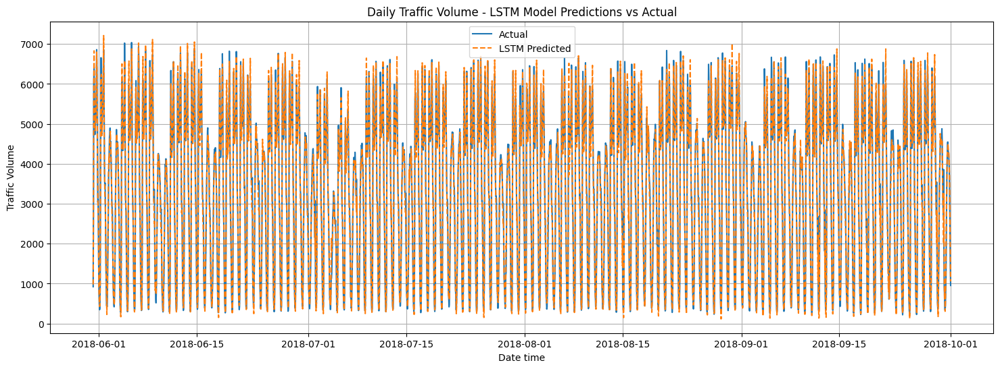

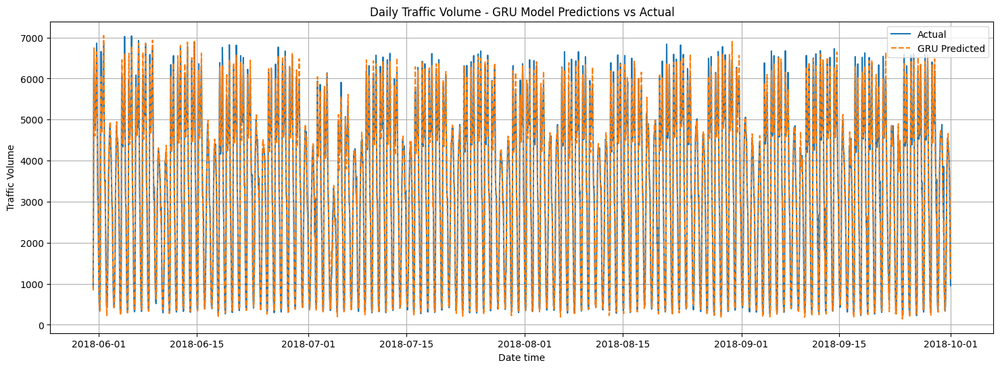

In [108]:
# Create a DataFrame for the LSTM predictions
lstm_predictions_df = pd.DataFrame(lstm_predictions, index=test_dl.index[window_in:], columns=['LSTM Predicted'])
lstm_comparison_df = pd.concat([test_dl['traffic_volume'][window_in:], lstm_predictions_df], axis=1)

# Plot the LSTM model predictions against the actual values
plt.figure(figsize=(18, 6))
plt.plot(lstm_comparison_df.index, lstm_comparison_df['traffic_volume'], label='Actual')
plt.plot(lstm_comparison_df.index, lstm_comparison_df['LSTM Predicted'], label='LSTM Predicted', linestyle='dashed')
plt.title('Daily Traffic Volume - LSTM Model Predictions vs Actual')
plt.xlabel('Date time')
plt.ylabel('Traffic Volume')
plt.legend()
plt.grid(True)
plt.show()

# Create a DataFrame for the GRU predictions
gru_predictions_df = pd.DataFrame(gru_predictions, index=test_dl.index[window_in:], columns=['GRU Predicted'])
gru_comparison_df = pd.concat([test_dl['traffic_volume'][window_in:], gru_predictions_df], axis=1)

# Plot the GRU model predictions against the actual values
plt.figure(figsize=(18, 6))
plt.plot(gru_comparison_df.index, gru_comparison_df['traffic_volume'], label='Actual')
plt.plot(gru_comparison_df.index, gru_comparison_df['GRU Predicted'], label='GRU Predicted', linestyle='dashed')
plt.title('Daily Traffic Volume - GRU Model Predictions vs Actual')
plt.xlabel('Date time')
plt.ylabel('Traffic Volume')
plt.legend()
plt.grid(True)
plt.show()

We can observe that both models attempt to follow the general patterns in the traffic volume, which includes the periodicity and spikes, and capture the general trend and periodicity of the traffic volume well, indicating they understand the temporal structure of the data.

The predictions for both models (red lines) align closely with the actual values (blue lines) in many cases, especially during regular traffic periods. But we can see some differences, such as:
- LSTM predictions appear to deviate slightly more during certain peaks or sharp changes (e.g., sudden increases or drops in traffic). This may suggest that the LSTM is slower to adapt to rapid changes compared to the GRU.
- GRU predictions seem to align better with the actual values during peak times and sharp transitions, suggesting it may be better at handling abrupt changes in traffic patterns. This model appears to have a slightly lower error overall based on the closeness of the red and blue lines.

Both models effectively capture the daily periodic patterns of traffic (e.g., repeated rises and falls in volume). However, there are moments where both models underestimate or overestimate traffic spikes. This is likely due to noise or rare events in the dataset that the models find hard to predict.

We can conclude based on the interpretation above that although both models do a good job capturing the overall traffic volume trends, GRU model demonstrates slightly better performance in adapting to rapid changes and predicting peaks accurately.

#### Predictions ploted on the entire time series

In [111]:
# Create DataFrames for the LSTM and GRU predictions
lstm_predictions_df = pd.DataFrame(lstm_predictions, index=test_dl.index[window_in:], columns=['LSTM Predicted'])
gru_predictions_df = pd.DataFrame(gru_predictions, index=test_dl.index[window_in:], columns=['GRU Predicted'])

# Concatenate the actual and predicted values for LSTM
comparison_df_lstm = pd.concat([final_df['traffic_volume'], lstm_predictions_df], axis=1)

# Plot the LSTM model predictions against the actual values
fig_lstm = px.line(comparison_df_lstm, title='Traffic Volume - LSTM Model Predictions vs Actual', width=1200, height=400)
fig_lstm.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig_lstm.update_yaxes(title_text='Traffic Volume')
fig_lstm.update_xaxes(title_text='Date Time')
fig_lstm.show()

# Concatenate the actual and predicted values for GRU
comparison_df_gru = pd.concat([final_df['traffic_volume'], gru_predictions_df], axis=1)

# Plot the GRU model predictions against the actual values
fig_gru = px.line(comparison_df_gru, title='Traffic Volume - GRU Model Predictions vs Actual', width=1200, height=400)
fig_gru.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(step="all")
        ])
    )
)
fig_gru.update_yaxes(title_text='Traffic Volume')
fig_gru.update_xaxes(title_text='Date Time')
fig_gru.show()

After observing the plots we can infer that:
- <b>LSTM:</b> The model predictions follow the general trend of the actual traffic volume. However, there are slight deviations during sharp peaks and valleys, indicating that the LSTM struggles slightly with capturing extreme variations in traffic. It may show a lag in responding to abrupt changes in traffic patterns, as seen in certain transitions.
- <b>GRU:</b> The model predictions also follow the general trend of actual traffic volume. Compared to LSTM, this model seems to handle abrupt transitions (e.g., sharp peaks and drops) slightly better, with closer alignment to the blue line, and the predictions appear smoother and more aligned, suggesting better handling of temporal dependencies.

With such results, we can conclude that GRU is better suited for this dataset than LSTM.

### Multi-step prediction with and 3 steps (M=3)
#### LSTM

In [113]:
# Define the window size and horizon
window_in = 24
horizon = 3

# Apply the sliding window function to the training data for multi-step prediction
train_transformed_dl_multi = sliding_window(train_dl[columns], target, window_in, horizon)

# Prepare the training data
X_train_dl_multi = tf.convert_to_tensor(train_transformed_dl_multi.iloc[:, :-horizon].values.reshape(train_transformed_dl_multi.shape[0], window_in, -1), dtype=tf.float32)
y_train_dl_multi = tf.convert_to_tensor(train_transformed_dl_multi.iloc[:, -horizon:].values, dtype=tf.float32)

# Transform the validation data using the sliding window function for multi-step prediction
valid_transformed_dl_multi = sliding_window(val_dl[columns], target, window_in, horizon)
X_valid_dl_multi = tf.convert_to_tensor(valid_transformed_dl_multi.iloc[:, :-horizon].values.reshape(valid_transformed_dl_multi.shape[0], window_in, -1), dtype=tf.float32)
y_valid_dl_multi = valid_transformed_dl_multi.iloc[:, -horizon:]

# Transform the test data using the sliding window function for multi-step prediction
test_transformed_dl_multi = sliding_window(test_dl[columns], target, window_in, horizon)
X_test_dl_multi = tf.convert_to_tensor(test_transformed_dl_multi.iloc[:, :-horizon].values.reshape(test_transformed_dl_multi.shape[0], window_in, -1), dtype=tf.float32)
y_test_dl_multi = test_transformed_dl_multi.iloc[:, -horizon:]

# Define the LSTM model for multi-step prediction
lstm_model_multi = Sequential()
lstm_model_multi.add(LSTM(50, activation='relu', input_shape=(window_in, X_train_dl_multi.shape[2])))
lstm_model_multi.add(Dense(horizon))
lstm_model_multi.compile(optimizer='adam', loss='mse')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Train the LSTM model
lstm_history_multi = lstm_model_multi.fit(X_train_dl_multi, y_train_dl_multi, epochs=150, callbacks=[early_stopping], validation_data=(X_valid_dl_multi, y_valid_dl_multi), verbose=1)

# Make multi-step predictions with the LSTM model
lstm_predictions_multi = lstm_model_multi.predict(X_test_dl_multi)

# Create DataFrames for the predictions
predictions_lstm_multi_df = pd.DataFrame(lstm_predictions_multi, index=y_test_dl_multi.index, columns=['LSTM_Step_1', 'LSTM_Step_2', 'LSTM_Step_3'])

# Add 24 hours to every date_time record in the predicted dfs to revert the sliding window transformation
predictions_lstm_multi_df.index = predictions_lstm_multi_df.index + pd.Timedelta(hours=24)

# Concatenate the actual and predicted values for each model
comparison_lstm_multi_df = pd.concat([test_dl['traffic_volume'], predictions_lstm_multi_df], axis=1)

Epoch 1/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 7451009.5000 - val_loss: 2428473.7500
Epoch 2/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 3894242.2500 - val_loss: 5267053.0000
Epoch 3/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 4511805.5000 - val_loss: 2973496.0000
Epoch 4/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 2890346.0000 - val_loss: 4074654.0000
Epoch 5/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 2506547.7500 - val_loss: 2478716.0000
Epoch 6/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 3677907.5000 - val_loss: 3256073.2500
Epoch 7/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 2859743.7500 - val_loss: 2676336.5000
Epoch 8/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 2415586.0000 - val_loss: 2036623.3750
Epoch 9/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 2416863.2500 - val_loss: 2691891.0000
Epoch 10/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 2125539.5000 - val_loss: 2491701.0000
Epoch 11

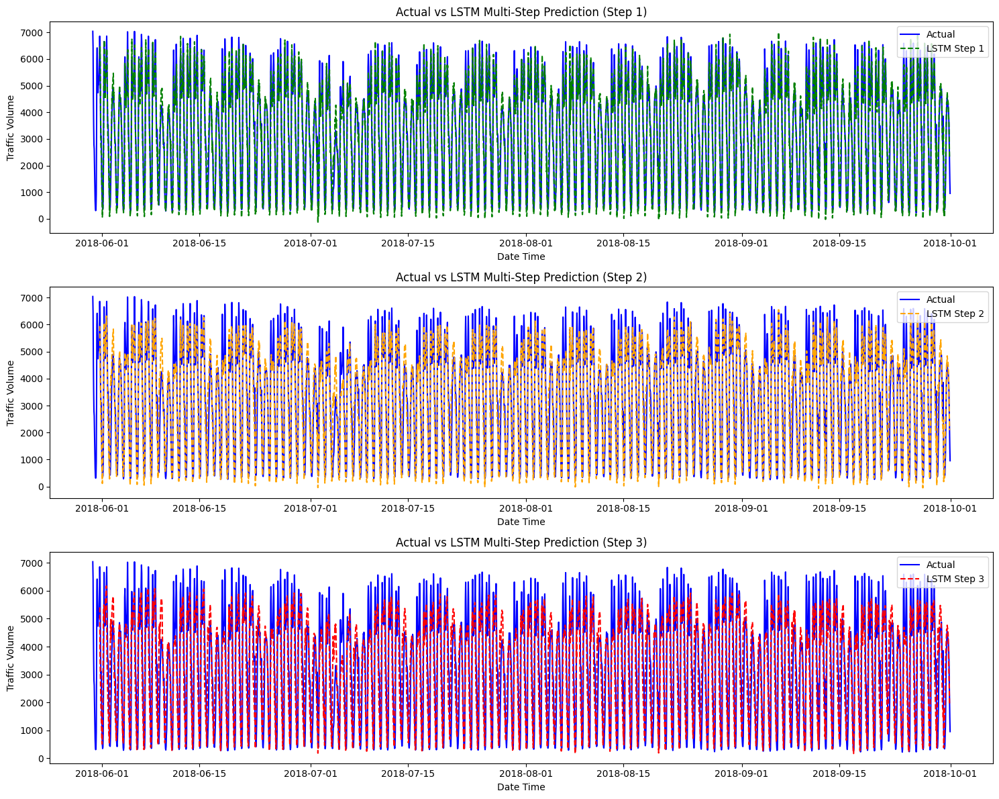

In [116]:
# Plot the actual vs predicted values for LSTM multi-step prediction
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

# Plot Step 1
axes[0].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['traffic_volume'], label='Actual', color='blue')
axes[0].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['LSTM_Step_1'], label='LSTM Step 1', color='green', linestyle='dashed')
axes[0].set_title('Actual vs LSTM Multi-Step Prediction (Step 1)')
axes[0].legend()

# Plot Step 2
axes[1].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['traffic_volume'], label='Actual', color='blue')
axes[1].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['LSTM_Step_2'], label='LSTM Step 2', color='orange', linestyle='dashed')
axes[1].set_title('Actual vs LSTM Multi-Step Prediction (Step 2)')
axes[1].legend()

# Plot Step 3
axes[2].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['traffic_volume'], label='Actual', color='blue')
axes[2].plot(comparison_lstm_multi_df.index, comparison_lstm_multi_df['LSTM_Step_3'], label='LSTM Step 3', color='red', linestyle='dashed')
axes[2].set_title('Actual vs LSTM Multi-Step Prediction (Step 3)')
axes[2].legend()

# Set axis titles
for ax in axes:
    ax.set_xlabel('Date Time')
    ax.set_ylabel('Traffic Volume')

# Adjust layout
plt.tight_layout()
plt.show()

The predicted lines closely follow the actual traffic volume, especially for LSTM_Step_1. As steps increase (Step_2 and Step_3), the deviations from the actual values slightly grow. This is expected due to errors from earlier predictions affect subsequent steps and increasing uncertainty in further time steps.

The model captures the daily traffic pattern well. Peaks and troughs align with the actual traffic volume and predictions reflect the cyclic nature of the data, such as rush hours and lower traffic during off-peak hours.

Short-Term Accuracy: LSTM_Step_1 predictions (blue line) are very close to the actual values, indicating the model effectively predicts the immediate next time step.
Longer-Term Divergence: LSTM_Step_2 (green) and LSTM_Step_3 (purple) show increasing deviation which suggests that the model struggles to maintain accuracy for longer horizons, which is common in multi-step forecasting due to accumulated errors.

The model shows strong performance early in the forecast horizon, consistent with the decreasing loss values observed in the logs (val_loss reaching ~670,000 in later epochs).
Occasional mismatches in predictions and actual values could relate to spikes in validation loss during training, possibly due to noise in the dataset.

We can conclude observing this plot that the LSTM model performs well for immediate predictions (Step_1) and reasonably well for slightly longer horizons (Step_2 and Step_3). While some deviations are expected for multi-step forecasting, overall, the model captures the cyclic traffic patterns effectively. The minor gaps for Step_2 and Step_3 highlight opportunities to refine the model for long-term predictions.

#### GRU

In [118]:
# Define the GRU model for multi-step prediction
gru_model_multi = Sequential()
gru_model_multi.add(GRU(50, activation='relu', input_shape=(window_in, X_train_dl_multi.shape[2])))
gru_model_multi.add(Dense(horizon))
gru_model_multi.compile(optimizer='adam', loss='mse')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Train the GRU model
gru_history_multi = gru_model_multi.fit(X_train_dl_multi, y_train_dl_multi, epochs=150, callbacks=[early_stopping], validation_data=(X_valid_dl_multi, y_valid_dl_multi.values), verbose=1)

# Make multi-step predictions with the GRU model
gru_predictions_multi = gru_model_multi.predict(X_test_dl_multi)

# Create DataFrames for the predictions
predictions_gru_multi_df = pd.DataFrame(gru_predictions_multi, index=y_test_dl_multi.index, columns=['GRU_Step_1', 'GRU_Step_2', 'GRU_Step_3'])

# Add 24 hours to every date_time record in the predicted dfs to revert the sliding window transformation
predictions_gru_multi_df.index = predictions_gru_multi_df.index + pd.Timedelta(hours=24)

# Concatenate the actual and predicted values for each model
comparison_gru_multi_df = pd.concat([test_dl['traffic_volume'], predictions_gru_multi_df], axis=1)

Epoch 1/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - loss: 6042454.0000 - val_loss: 926138.6250
Epoch 2/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 1032770.5000 - val_loss: 916826.5625
Epoch 3/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 1337402.0000 - val_loss: 1084347.7500
Epoch 4/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 878065.2500 - val_loss: 1088444.8750
Epoch 5/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 1426279.7500 - val_loss: 886640.2500
Epoch 6/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 788625.6875 - val_loss: 786135.5000
Epoch 7/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 807484.2500 - val_loss: 808992.5625
Epoch 8/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 883701.6875 - val_loss: 941677.8125
Epoch 9/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 1207116.7500 - val_loss: 925899.5625
Epoch 10/150
445/445 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 876818.4375 - val_loss: 816169.3125
Epoch 11/150
445/445 ━

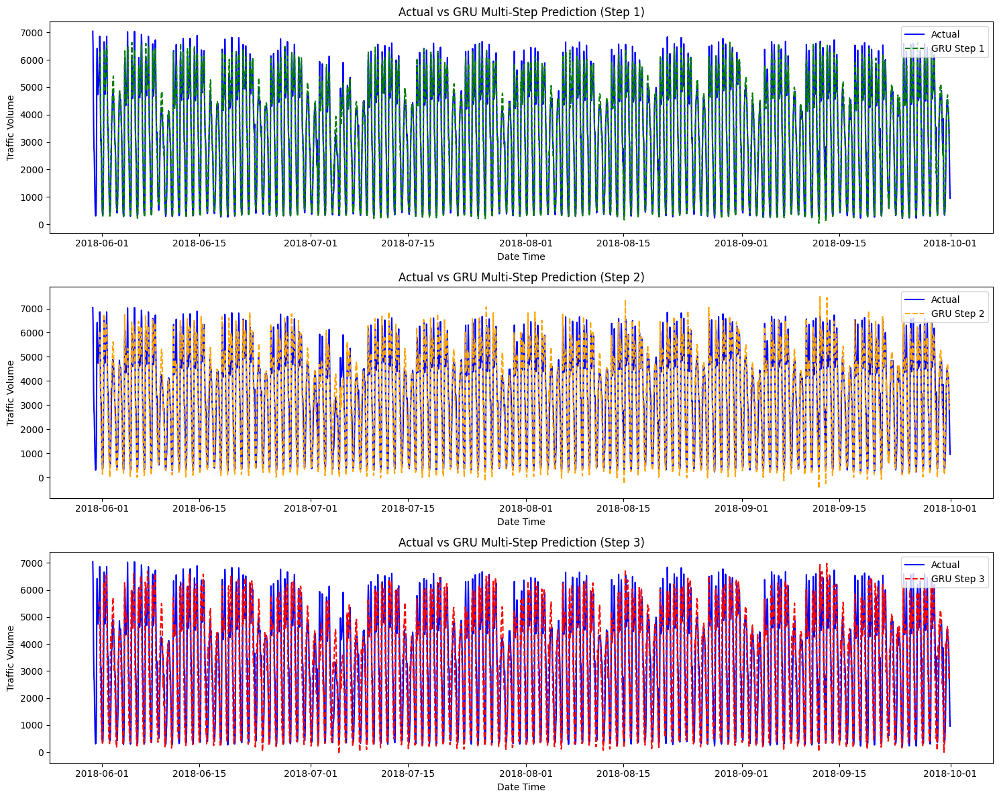

In [120]:
# Plot the actual vs predicted values for GRU multi-step prediction
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

# Plot Step 1
axes[0].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['traffic_volume'], label='Actual', color='blue')
axes[0].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['GRU_Step_1'], label='GRU Step 1', color='green', linestyle='dashed')
axes[0].set_title('Actual vs GRU Multi-Step Prediction (Step 1)')
axes[0].legend()

# Plot Step 2
axes[1].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['traffic_volume'], label='Actual', color='blue')
axes[1].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['GRU_Step_2'], label='GRU Step 2', color='orange', linestyle='dashed')
axes[1].set_title('Actual vs GRU Multi-Step Prediction (Step 2)')
axes[1].legend()

# Plot Step 3
axes[2].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['traffic_volume'], label='Actual', color='blue')
axes[2].plot(comparison_gru_multi_df.index, comparison_gru_multi_df['GRU_Step_3'], label='GRU Step 3', color='red', linestyle='dashed')
axes[2].set_title('Actual vs GRU Multi-Step Prediction (Step 3)')
axes[2].legend()

# Set axis titles
for ax in axes:
    ax.set_xlabel('Date Time')
    ax.set_ylabel('Traffic Volume')

# Adjust layout
plt.tight_layout()
plt.show()

As we can see on the plot above GRU_Step_1 closely follows the actual traffic volume, indicating that the model effectively captures immediate patterns in the data, while GRU_Step_2 and GRU_Step_3 show increasing divergence from actual traffic volume. This is expected in multi-step forecasting, as prediction errors accumulate with each step.

The GRU model successfully captures the cyclic nature of traffic volume, with peaks and troughs aligning with actual data which means that the model has learned the daily traffic patterns (e.g., rush hours and off-peak hours).

The training and validation loss decrease steadily over epochs, indicating that the model is learning and improving over time.

The val_loss stabilizes at the end of training, suggesting the model generalizes well to unseen data and the spikes might indicate sensitivity to noise in the data.

Based on the interpretation above, we can conclude that GRU model performs well for short-term predictions (Step 1) and adequately captures daily traffic cycles. However, the divergence in longer-term predictions (Step 2 and Step 3) highlights the inherent challenges of multi-step forecasting and the need for additional optimization or external features to improve accuracy for extended horizons.

#### Evaluate both multi-step predictions, GRU and LSTM, with mae, mse and mape

In [121]:
# Evaluate LSTM multi-step predictions
lstm_mae_multi = mean_absolute_error(y_test_dl_multi, lstm_predictions_multi)
lstm_mse_multi = mean_squared_error(y_test_dl_multi, lstm_predictions_multi)
lstm_mape_multi = mean_absolute_percentage_error(y_test_dl_multi, lstm_predictions_multi)

# Evaluate GRU multi-step predictions
gru_mae_multi = mean_absolute_error(y_test_dl_multi, gru_predictions_multi)
gru_mse_multi = mean_squared_error(y_test_dl_multi, gru_predictions_multi)
gru_mape_multi = mean_absolute_percentage_error(y_test_dl_multi, gru_predictions_multi)

# Create a DataFrame to display the results
results_multi_df = pd.DataFrame({
    'Model': ['LSTM Multi-Step', 'GRU Multi-Step'],
    'MAE': [lstm_mae_multi, gru_mae_multi],
    'MSE': [lstm_mse_multi, gru_mse_multi],
    'MAPE': [lstm_mape_multi, gru_mape_multi]
})

# Display the evaluation metrics without the row index
display(results_multi_df.style.hide(axis='index'))

Model,MAE,MSE,MAPE
LSTM Multi-Step,456.603938,501826.689873,0.224697
GRU Multi-Step,342.180528,238393.814900,0.161276


Considering the MAE, MSE, and MAPE values obtained it is possible to infer that the GRU model clearly outperforms LSTM in this scenario, offering significantly lower errors (both absolute and relative). Its simplicity and efficiency make it a better choice for multi-step traffic volume forecasting, especially when computational resources or interpretability are a concern.

## Conclusions
### Compare best method from each class against each others and test data

In this section we will compare the best models of each class against each others and actual test data. The best model of each class was chosen purely on the metrics results of MAE, MSE and MAPE.

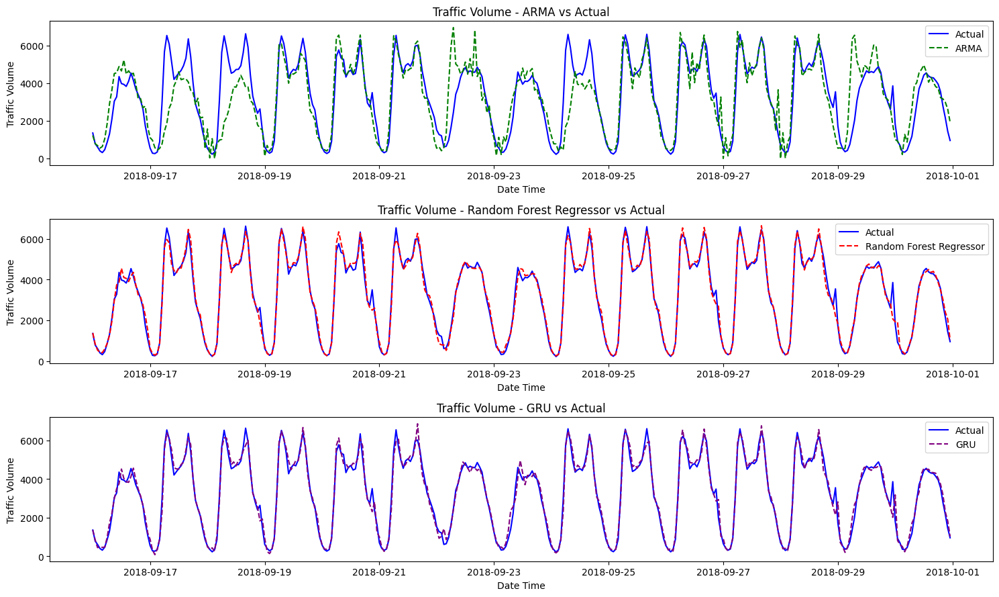

In [149]:
# Create DataFrames for the predictions
arma_predictions_df = forecast_arma_df.rename(columns={'ARMA Prediction': 'ARMA'})
rf_predictions_df = pd.DataFrame(y_pred_mae_1, index=y_test_1.index, columns=['Random Forest Regressor'])
gru_predictions_df = pd.DataFrame(gru_predictions, index=test_dl.index[window_in:], columns=['GRU'])

# Adjust the indices of the prediction DataFrames
rf_predictions_df.index = rf_predictions_df.index + pd.Timedelta(hours=24)

# Align the indices of the prediction DataFrames with aux_test
arma_predictions_df = arma_predictions_df.reindex(aux_test.index)
rf_predictions_df = rf_predictions_df.reindex(aux_test.index)
gru_predictions_df = gru_predictions_df.reindex(aux_test.index)

# Concatenate the actual and predicted values
comparison_df_arma = pd.concat([aux_test['traffic_volume'], arma_predictions_df], axis=1)
comparison_df_rf = pd.concat([aux_test['traffic_volume'], rf_predictions_df], axis=1)
comparison_df_gru = pd.concat([aux_test['traffic_volume'], gru_predictions_df], axis=1)

# Create a figure with 1 column and 3 rows
fig, axes = plt.subplots(3, 1, figsize=(15, 9))

# Plot the actual vs predicted values for ARMA
axes[0].plot(comparison_df_arma.index, comparison_df_arma['traffic_volume'], label='Actual', color='blue')
axes[0].plot(comparison_df_arma.index, comparison_df_arma['ARMA'], label='ARMA', color='green', linestyle='dashed')
axes[0].set_title('Traffic Volume - ARMA vs Actual')
axes[0].set_xlabel('Date Time')
axes[0].set_ylabel('Traffic Volume')
axes[0].legend()

# Plot the actual vs predicted values for Random Forest Regressor
axes[1].plot(comparison_df_rf.index, comparison_df_rf['traffic_volume'], label='Actual', color='blue')
axes[1].plot(comparison_df_rf.index, comparison_df_rf['Random Forest Regressor'], label='Random Forest Regressor', color='red', linestyle='dashed')
axes[1].set_title('Traffic Volume - Random Forest Regressor vs Actual')
axes[1].set_xlabel('Date Time')
axes[1].set_ylabel('Traffic Volume')
axes[1].legend()

# Plot the actual vs predicted values for GRU
axes[2].plot(comparison_df_gru.index, comparison_df_gru['traffic_volume'], label='Actual', color='blue')
axes[2].plot(comparison_df_gru.index, comparison_df_gru['GRU'], label='GRU', color='purple', linestyle='dashed')
axes[2].set_title('Traffic Volume - GRU vs Actual')
axes[2].set_xlabel('Date Time')
axes[2].set_ylabel('Traffic Volume')
axes[2].legend()

# Adjust layout
plt.tight_layout()
plt.show()

The ARMA plot struggles to capture the true complexity of the traffic volume data. The predicted values deviate significantly from the actual traffic volume, particularly around peaks and troughs. 

The Random Forest Regressor performs much better than ARMA. The red dashed line aligns closely with the actual blue line, capturing the overall trends, peaks, and troughs more accurately.

The GRU model aligns very closely with the actual traffic volume data. This model captures not only the peaks and troughs but also the subtle patterns and fluctuations in the data.


As we can conclude:
- ARMA is a linear model and may not handle the non-linearities and seasonality well, which are evident in this dataset.
- Random Forest Regressos, despite the minor deviations, is better suited for capturing the complexity of the traffic volume data due to its ability to model non-linear relationships.
- GRU's recurrent architecture allows it to better understand the temporal dependencies, which is crucial for time series data like traffic volume.

### Compare the three models using MAE, MSE and MAPE

In [125]:
# Evaluate ARMA model
arma_mae = mean_absolute_error(aux_test['traffic_volume'], forecast_arma_df['ARMA Prediction'])
arma_mse = mean_squared_error(aux_test['traffic_volume'], forecast_arma_df['ARMA Prediction'])
arma_mape = mean_absolute_percentage_error(aux_test['traffic_volume'], forecast_arma_df['ARMA Prediction'])

# Evaluate Random Forest Regressor model
rf_mae = mean_absolute_error(y_test_1, y_pred_mae_1)
rf_mse = mean_squared_error(y_test_1, y_pred_mae_1)
rf_mape = mean_absolute_percentage_error(y_test_1, y_pred_mae_1)

# Evaluate GRU model
gru_mae = mean_absolute_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)
gru_mse = mean_squared_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)
gru_mape = mean_absolute_percentage_error(test_transformed_dl['traffic_volume_t+1'], gru_predictions)

# Combine the results into a DataFrame
comparison_metrics_df = pd.DataFrame({
    'Model': ['ARMA', 'Random Forest Regressor', 'GRU'],
    'MAE': [arma_mae, rf_mae, gru_mae],
    'MSE': [arma_mse, rf_mse, gru_mse],
    'MAPE': [arma_mape, rf_mape, gru_mape]
})

# Display the evaluation metrics
display(comparison_metrics_df.style.hide(axis='index'))

Model,MAE,MSE,MAPE
ARMA,726.616667,1311938.472222,0.388336
Random Forest Regressor,136.229718,42971.199910,0.055556
GRU,170.185352,58571.845800,0.081023


```markdown
Based on the comprehensive analysis and comparison of various models for traffic volume prediction, we can draw the following conclusions:

1. **Random Forest Regressor**:
    - This model consistently outperforms others in terms of accuracy, as evidenced by the lowest MAE, MSE, and MAPE values.
    - It effectively captures both linear and non-linear patterns in the traffic data, making it highly suitable for this task.
    - The Random Forest Regressor's ability to handle complex interactions and variability in the data makes it the best-performing model overall.

2. **GRU (Gated Recurrent Unit)**:
    - While GRU is designed for sequential data and performs well, it does not surpass the Random Forest Regressor in this case.
    - GRU models show strong performance in capturing temporal dependencies and cyclic patterns in the data.
    - The GRU model's performance indicates that it is a viable alternative, especially for tasks requiring deep learning approaches.

3. **ARMA (AutoRegressive Moving Average)**:
    - The ARMA model, being linear, struggles to capture the non-linear and seasonal patterns present in the traffic volume data.
    - Its performance is significantly lower compared to the Random Forest Regressor and GRU models.
    - ARMA's limitations highlight the importance of choosing models that can handle the complexity of the data.

In conclusion, the Random Forest Regressor emerges as the most effective model for predicting traffic volume in this dataset. It balances accuracy and complexity, making it the preferred choice. The GRU model also shows promise, particularly for sequential data tasks, but requires further optimization to match the performance of the Random Forest Regressor. The ARMA model, while useful for simpler datasets, is not suitable for this type of complex time series data.
```